# Approximating a region of the sine function

In this notebook we will approximate a region of the sine function with a neural network to get a sense of how architecture and hyperparameters affect neural network performance

In [3]:
import sys
import numpy as np
from matplotlib import pyplot
import torch
import torch.nn as nn
from torch import optim
from torch.utils.data import DataLoader
from torch.utils.data.dataset import Dataset
from icecream import ic

import random

ic("USING pytorch VERSION: ", torch.__version__)

ic| 'USING pytorch VERSION: ', torch.__version__: '1.6.0'


('USING pytorch VERSION: ', '1.6.0')

In [4]:
# Simulation specific parameters

# How many timesteps per simulation and for how long.
time = 10
timestep = 0.005

## Generate training data
We can synthesize our own data for this practice problem by computing the sin(x) for a range of x values, and adding some noise

In [5]:
def gen_train_and_test_data(num_inputs,num_outputs, phase_offset=False, random_inputs=False, joint_outputs_to_input=False, time_delay=1, for_back_only=False):
  """ Generate the training data for a sine wave.

    Args:
    phase_offset: radians between 0 and 2*pi that allows us to shift the desired 
      sine wave as needed.
    random_inputs: simulate random inputs from non-oscillating inputs.
    for_back_only: are we only simulating the forward and backward movements?  
      - Even numbered joints are outward movement away from medial line of body.
      - Set the outwards to 0.1
    Returns:
      training and testing data for one output.
    """
  # If no phase offset desired, go with normal sine wave.
  if not phase_offset:
    phase_offset = [0 for _ in range(num_outputs)]

  n_x_train = 30000   # the number of training datapoints
  n_x_test = 8000     # the number of testing datapoints

  x_train = []  # Initialize a vector of with dimensions [n_x, 1] and extend
  #x_train = 
  sin_timepoints = np.random.rand(n_x_train,1)*time
  x_train.append(sin_timepoints.ravel())

  # Are we simulating random input data or base data?
  if random_inputs:
    # Append random touch values.
    for _ in range(4):
      x_train.append(np.array([1 if random.random() < 0.5 else 0 for _ in range(n_x_train)], dtype=float))

    for _ in range(num_inputs-1-4):
      x_train.append(np.random.uniform(low=-0.75, high=0.75, size=(n_x_train,)))
  else:
    for _ in range(num_inputs-1):
      x_train.append(np.zeros(n_x_train))

  x_train = np.array(x_train)
  ic(np.shape(x_train))
  x_train = x_train.transpose()
  ic(np.shape(x_train))
  y_train = []
  for i in range(num_outputs):
    if for_back_only and i > 1 and i % 2 == 0:
      y_train.append(np.array([[0.1 for _ in range(np.shape(x_train)[0])]], dtype=float).reshape(np.shape(x_train)[0],1))
    else:
      y_train.append(np.sin(2.0 * np.pi * sin_timepoints + phase_offset[i])) #/2.5           # Calculate the sin of all data points in the x vector and reduce amplitude
  y_train = np.array(y_train)
  y_train = y_train.transpose()[0]
  ic(np.shape(y_train))

  # Replace inputs with outputs of the training data offset by a time delay factor.
  # Used when training an ANN where joint outputs are then provided as inputs.
  if joint_outputs_to_input:
    x_train = x_train.transpose()
    y_train = y_train.transpose()
    for i in range(5,num_inputs):
      x_train[i] = np.insert(y_train[i-5], 0, 0)[:-1]
    x_train = x_train.transpose()
    y_train = y_train.transpose()
  #y_train += (np.random.randn(n_x_train, 1)/20)  # add noise to each datapoint

  x_test = []
  #x_test = 
  sin_test_timepoints = np.random.rand(n_x_test, 1)*time   # Repeat data generation for test set
  x_test.append(sin_test_timepoints.ravel())
  # for _ in range(num_inputs-1):
  #  x_test.append(np.zeros(n_x_test))
  
  # Are we simulating random input data or base data?
  if random_inputs:
    # Append random touch values.
    for _ in range(4):
      x_test.append(np.array([1 if random.random() < 0.5 else 0 for _ in range(n_x_test)], dtype=float))

    for _ in range(num_inputs-1-4):
      x_test.append(np.random.uniform(low=-0.75, high=0.75, size=(n_x_test,)))
  else:
    for _ in range(num_inputs-1):
      x_test.append(np.zeros(n_x_test))

  x_test = np.array(x_test)
  x_test = x_test.transpose()
  y_test = []
  for i in range(num_outputs):
    if for_back_only and i > 1 and i % 2 == 0:
      y_test.append(np.array([[0.1 for _ in range(np.shape(x_test)[0])]], dtype=float).reshape(np.shape(x_test)[0],1))
    else:
      y_test.append(np.sin(2.0 * np.pi * sin_test_timepoints + phase_offset[i])) #/2.5           # Calculate the sin of all data points in the x vector and reduce amplitude
  y_test = np.array(y_test)
  y_test = y_test.transpose()[0]

  # Replace inputs with outputs of the training data offset by a time delay factor.
  # Used when training an ANN where joint outputs are then provided as inputs.
  if joint_outputs_to_input:
    x_test = x_test.transpose()
    y_test = y_test.transpose()
    for i in range(5,num_inputs):
      x_test[i] = np.insert(y_test[i-5], 0, 0)[:-1]
    x_test = x_test.transpose()
    y_test = y_test.transpose()

  #y_test += (np.random.randn(n_x_test, 1)/20)

  return x_train, y_train, x_test, y_test

def plot_xy_data(x_data, y_data):
  for i, yd in enumerate(y_data):
    ic("x min: ", np.min(x_data))
    ic("x max:", np.max(x_data))
    ic("y min: ", np.min(yd))
    ic("y max:", np.max(yd))

    fig0 = pyplot.figure(dpi=300)  # initialize a plot
    fig0.set_size_inches(8,6)
    pyplot.scatter(x_data, y_data, marker='o', s=0.2)  # plot x vs y
    pyplot.show()  # open a window with the plot (you have to close it for the script to finish)

x_train, y_train, x_test, y_test = gen_train_and_test_data(200, 200)
ic(len(x_train))
ic(len(y_train))
# plot_xy_data(x_data=x_train, y_data=y_train)


ic| np.shape(x_train): (200, 30000)
ic| np.shape(x_train): (30000, 200)
ic| np.shape(y_train): (30000, 200)
ic| len(x_train): 30000
ic| len(y_train): 30000


30000

## Define a pytorch Dataset object to contain the training and testing data
Pytorch handles data shuffling and batch loading, as long as the user provides a "Dataset" class. This class is just a wrapper for your data that casts the data into pytorch tensor format and returns slices of the data. In this case, our data is in numpy format, which conveniently pytorch has a method for converting to their native format.

In [6]:
class SineDataset(Dataset):
    def __init__(self, x, y):
        x_dtype = torch.FloatTensor
        y_dtype = torch.FloatTensor     # for MSE or L1 Loss

        self.length = x.shape[0]

        self.x_data = torch.from_numpy(x).type(x_dtype)
        self.y_data = torch.from_numpy(y).type(y_dtype)

    def __getitem__(self, index):
        return self.x_data[index], self.y_data[index]

    def __len__(self):
        return self.length

## Define training methods for the model
These methods use an initialized model and training data to iteratively perform the forward and backward pass of optimization. Aside from some data reformatting that depends on the input, output, and loss function, these methods will always be the same for any shallow neural network.

In [7]:
def train_batch(model, x, y, optimizer, loss_fn):
    # Run forward calculation
    y_predict = model.forward(x)

    # Compute loss.
    loss = loss_fn(y_predict, y)

    # Before the backward pass, use the optimizer object to zero all of the
    # gradients for the variables it will update (which are the learnable weights
    # of the model)
    optimizer.zero_grad()

    # Backward pass: compute gradient of the loss with respect to model
    # parameters
    loss.backward()

    # Calling the step function on an Optimizer makes an update to its
    # parameters
    optimizer.step()

    return loss.data.item()


def train(model, loader, optimizer, loss_fn, epochs=5):
    losses = list()

    batch_index = 0
    for e in range(epochs):
        for x, y in loader:
            loss = train_batch(model=model, x=x, y=y, optimizer=optimizer, loss_fn=loss_fn)
            losses.append(loss)

            batch_index += 1

        if e % 50 == 0:
          ic("Epoch: ", e+1)
          ic("Batches: ", batch_index)

    return losses


## Define testing methods for the model
These methods are like training, but we don't need to update the parameters of the model anymore because when we call the test() method, the model has already been trained. Instead, this method just calculates the predicted y values and returns them, AKA the forward pass.

In [8]:
def test_batch(model, x, y):
    # run forward calculation
    y_predict = model.forward(x)

    return y, y_predict


def test(model, loader):
    y_vectors = list()
    y_predict_vectors = list()

    batch_index = 0
    for x, y in loader:
        y, y_predict = test_batch(model=model, x=x, y=y)

        y_vectors.append(y.data.numpy())
        y_predict_vectors.append(y_predict.data.numpy())

        batch_index += 1

    y_predict_vector = np.concatenate(y_predict_vectors)

    return y_predict_vector


## Define plotting method for loss
This is a plotting method for looking at the behavior of the loss over training iterations.

In [9]:
def plot_loss(losses, show=True):
    fig = pyplot.gcf()
    fig.set_size_inches(8,6)
    ax = pyplot.axes()
    ax.set_xlabel("Iteration")
    ax.set_ylabel("Loss")
    x_loss = list(range(len(losses)))
    pyplot.plot(x_loss, losses)

    if show:
        pyplot.show()

    pyplot.close()


## Define model architecture
Finally we can define a model to be trained. This is a very simple template that will not perform well on a complicated task. Without the activation function, this model would be a NN implementation of linear regression.

The following architecture parameters are defined here:
- number of layers
- size of layers
- activation function

This is where your weight matrices are defined. Between each layer, the weight matrix needs to have dimensions i x j where i is your input size and j is your output size. In other words, each weight contained in a matrix connects the i'th input node of the previous layer with the j'th output node of next layer. If your input layer is 40 and your output layer is 90, you need a 40 x 90 matrix to store all the connecting weights: torch.nn.Linear(40, 90).

In the forward() method, the input vector x is sequentially operated on by the layers of the model. The training and testing method calls forward() to calculate the model's output.

See the pytorch documentation for a full list of available activation functions:
http://pytorch.org/docs/master/nn.html#non-linear-activation-functions

Try switching between these 3 and see if there is a notable difference in the rate of convergence or closeness of the fit:
- `relu()`
- `sigmoid()`
- `tanh()`

Try adding more layers to the model by defining them in the init method and adding them to the forward pass method.

In [10]:
class PytorchBrain(torch.nn.Module):
    _id = 0 # Global genome identifier
    _num_inputs = 33
    _num_outputs = 28

    # @classmethod
    # def __get_new_id(cls):
    #     cls._id += 1
    #     return cls._id

    @classmethod
    def get_num_outputs(cls):
        return cls._num_outputs

    def __init__(self):
        super().__init__()
        
        # Inputs to hidden layer linear transformation
        self.hidden = torch.nn.Linear(PytorchBrain._num_inputs, 16)
        self.hidden_2 = torch.nn.Linear(16, 16)
        self.hidden_3 = torch.nn.Linear(16, 16)
        self.hidden_4 = torch.nn.Linear(16, 16)
        # Output layer, 2 outputs to match to sine and cosine.
        self.output = torch.nn.Linear(16, PytorchBrain._num_outputs)
        
        # Define sigmoid activation
        self.sigmoid = torch.nn.Sigmoid()
        self.tanh = torch.nn.Tanh()
        
    def forward(self, x):
        # Pass the input tensor through each of our operations
        x = self.hidden(x)
        x = self.sigmoid(x)
        x = self.hidden_2(x)
        x = self.sigmoid(x)
        x = self.hidden_3(x)
        x = self.sigmoid(x)
        x = self.hidden_4(x)
        x = self.tanh(x)
        x = self.output(x)
        
        return x

## Method to define hyperparameters, train, and test

Here we define the following parameters for training:

- batch size
- learning rate
- optimizer
- loss function

Ideally, numeric parameters would be tested empirically with an exhaustive search. When testing manually, It is recommended to maximize the model fit with one parameter at a time to avoid confounding your results. 

Try these learning rates:
- 5e-2, 1e-2, 5e-3, 1e-3, 5e-4, 1e-4, 5e-5

Try these optimizers:
- `optim.SGD(shallow_model.parameters(), lr=learning_rate)`
- `optim.Adam(shallow_model.parameters(), lr=learning_rate)`

See the pytorch documentation pages for an extensive list of options:
- Optimizers: http://pytorch.org/docs/master/optim.html#algorithms
- Loss: http://pytorch.org/docs/master/nn.html#id46

Read this page for a detailed comparison of optimizers: http://ruder.io/optimizing-gradient-descent/



In [11]:
def run(dataset_train, dataset_test, epochs=4):
    # Batch size is the number of training examples used to calculate each iteration's gradient
    batch_size_train = 16
    
    data_loader_train = DataLoader(dataset=dataset_train, batch_size=batch_size_train, shuffle=True)
    data_loader_test = DataLoader(dataset=dataset_test, batch_size=len(dataset_test), shuffle=False)
    
    # Define the hyperparameters
    learning_rate = 1e-3
    pytorch_model = PytorchBrain()
    
    # Initialize the optimizer with above parameters
    optimizer = optim.Adam(pytorch_model.parameters(), lr=learning_rate)

    # Define the loss function
    loss_fn = nn.MSELoss()  # mean squared error

    # Train and get the resulting loss per iteration
    loss = train(model=pytorch_model, loader=data_loader_train, optimizer=optimizer, loss_fn=loss_fn, epochs=epochs)
    
    # Test and get the resulting predicted y values
    y_predict = test(model=pytorch_model, loader=data_loader_test)

    return loss, y_predict, pytorch_model


In [12]:
# from google.colab import drive
# drive.mount('/content/gdrive')

## Initiate training, plot testing results
In this cell we put all the previous methods together to train and test the model. By default we will iterate through the training dataset 5 times before looking at the results. This problem is an unusal one in that our loss is the best quantitative metric of the model performance. Classification problems require further analysis of true/false positives/negatives. 

Rerun this cell several times without editing any parameters. Is the result the same?

Try a larger batch size, how is the training time affected?

Look at the slope and noise level of the loss plot. Does it look like the training converged on a local minimum? 

In [1]:
x_train, y_train, x_test, y_test = gen_train_and_test_data(1, 28, phase_offset=[(np.pi * i)/28.0 for i in range(28)])

dataset_train = SineDataset(x=x_train, y=y_train)
dataset_test = SineDataset(x=x_test, y=y_test)

ic("Train set size: ", dataset_train.length)
ic("Test set size: ", dataset_test.length)

losses, y_predict = run(dataset_train=dataset_train, dataset_test=dataset_test, epochs=400)

ic("Final loss:", sum(losses[-100:])/100)
plot_loss(losses)

# Transpose the matrices so we can plot.
y_test = y_test.transpose()
y_predict = y_predict.transpose()

for yt, yp in zip(y_test, y_predict):
  fig2 = pyplot.figure(dpi=300)
  fig2.set_size_inches(8,6)
  pyplot.scatter(x_test, yt, marker='o', s=0.2)
  pyplot.scatter(x_test, yp, marker='o', s=0.3)
  pyplot.text(-9, 0.44, "- Prediction", color="orange", fontsize=8)
  pyplot.text(-9, 0.48, "- Sine (with noise)", color="blue", fontsize=8)
  pyplot.show()


NameError: name 'gen_train_and_test_data' is not defined

In [15]:
# Generate a trained NN with 0's for touch and joint angle sensors and 
# no phase offset for any joint.
x_train, y_train, x_test, y_test = gen_train_and_test_data(33, 28, phase_offset=[0 for i in range(28)])

ic(type(x_train))
ic(type(y_train))
ic(type(x_test))
ic(type(y_test))

ic(np.shape(x_train))
ic(np.shape(y_train))

dataset_train = SineDataset(x=x_train, y=y_train)
dataset_test = SineDataset(x=x_test, y=y_test)

ic("Train set size: ", dataset_train.length)
ic("Test set size: ", dataset_test.length)

losses, y_predict, model = run(dataset_train=dataset_train, dataset_test=dataset_test, epochs=600)

ic("Final loss:", sum(losses[-100:])/100)
plot_loss(losses)


y_test = y_test.transpose()
y_predict = y_predict.transpose()

for yt, yp in zip(y_test, y_predict):
  x_data = x_test.transpose()[0]
  ic(np.shape(x_data))
  ic(np.shape(yt))
  #ic(x_test.shape())
  fig2 = pyplot.figure(dpi=300)
  fig2.set_size_inches(4,3)
  pyplot.scatter(x_data, yt, marker='o', s=0.2)
  pyplot.scatter(x_data, yp, marker='o', s=0.3)
  pyplot.text(-9, 0.44, "- Prediction", color="orange", fontsize=8)
  pyplot.text(-9, 0.48, "- Sine (with noise)", color="blue", fontsize=8)
  pyplot.show()


ic| np.shape(x_train): (33, 30000)
ic| np.shape(x_train): (30000, 33)
ic| np.shape(y_train): (30000, 28)
ic| type(x_train): <class 'numpy.ndarray'>
ic| type(y_train): <class 'numpy.ndarray'>
ic| type(x_test): <class 'numpy.ndarray'>
ic| type(y_test): <class 'numpy.ndarray'>
ic| np.shape(x_train): (30000, 33)
ic| np.shape(y_train): (30000, 28)
ic| 'Train set size: ', dataset_train.length: 30000
ic| 'Test set size: ', dataset_test.length: 8000
ic| 'Epoch: ', e+1: 1
ic| 'Batches: ', batch_index: 1875
ic| 'Epoch: ', e+1: 51
ic| 'Batches: ', batch_index: 95625
ic| 'Epoch: ', e+1: 101
ic| 'Batches: ', batch_index: 189375


In [ ]:
# from google.colab import drive
# drive.mount('/content/gdrive')

#model_save_name = 'sine_no_offset.pt'
#path = F"/content/gdrive/My Drive/{model_save_name}" 
#torch.save(model.state_dict(), path)

In [ ]:
# Generate a trained NN with ranodm values for touch and joint angle sensors and 
# half a phase offset for knee joints.
x_train, y_train, x_test, y_test = gen_train_and_test_data(33, 28, phase_offset=[0 if i not in [12,13,14,15,16,17,18,19] else np.pi for i in range(28)], random_inputs=True)

ic(type(x_train))
ic(type(y_train))
ic(type(x_test))
ic(type(y_test))

ic(np.shape(x_train))
ic(np.shape(y_train))

dataset_train = SineDataset(x=x_train, y=y_train)
dataset_test = SineDataset(x=x_test, y=y_test)

ic("Train set size: ", dataset_train.length)
ic("Test set size: ", dataset_test.length)

losses, y_predict, model = run(dataset_train=dataset_train, dataset_test=dataset_test, epochs=1000)

ic("Final loss:", sum(losses[-100:])/100)
plot_loss(losses)


y_test = y_test.transpose()
y_predict = y_predict.transpose()

for yt, yp in zip(y_test, y_predict):
  x_data = x_test.transpose()[0]
  ic(np.shape(x_data))
  ic(np.shape(yt))
  #ic(x_test.shape())
  fig2 = pyplot.figure(dpi=300)
  fig2.set_size_inches(8,6)
  pyplot.scatter(x_data, yt, marker='o', s=0.2)
  pyplot.scatter(x_data, yp, marker='o', s=0.3)
  pyplot.text(-9, 0.44, "- Prediction", color="orange", fontsize=8)
  pyplot.text(-9, 0.48, "- Sine (with noise)", color="blue", fontsize=8)
  pyplot.show()


In [ ]:
# from google.colab import drive
# drive.mount('/content/gdrive')

model_save_name = 'sine_knees_one_phase_offset_random_inputs.pt'
path = F"/content/gdrive/My Drive/{model_save_name}" 
torch.save(model.state_dict(), path)

In [29]:
# Generate a network where the outputs of the ANN are fed back into the inputs on the next timestep.
x_train, y_train, x_test, y_test = gen_train_and_test_data(33, 28, phase_offset=[(np.pi * i)/28.0 for i in range(28)], joint_outputs_to_input=True)

ic(type(x_train))
ic(type(y_train))
ic(type(x_test))
ic(type(y_test))

ic(np.shape(x_train))
ic(np.shape(y_train))

dataset_train = SineDataset(x=x_train, y=y_train)
dataset_test = SineDataset(x=x_test, y=y_test)

ic("Train set size: ", dataset_train.length)
ic("Test set size: ", dataset_test.length)

losses, y_predict, model = run(dataset_train=dataset_train, dataset_test=dataset_test, epochs=1000)

ic("Final loss:", sum(losses[-100:])/100)
plot_loss(losses)


y_test = y_test.transpose()
y_predict = y_predict.transpose()

for yt, yp in zip(y_test, y_predict):
  x_data = x_test.transpose()[0]
  #ic(np.shape(x_data))
  #ic(np.shape(yt))
  #ic(x_test.shape())
  fig2 = pyplot.figure(dpi=300)
  fig2.set_size_inches(8,6)
  pyplot.scatter(x_data, yt, marker='o', s=0.2)
  pyplot.scatter(x_data, yp, marker='o', s=0.3)
  pyplot.text(-9, 0.44, "- Prediction", color="orange", fontsize=8)
  pyplot.text(-9, 0.48, "- Sine (with noise)", color="blue", fontsize=8)
  pyplot.show()

ic| np.shape(x_train): (33, 30000)
ic| np.shape(x_train): (30000, 33)
ic| np.shape(y_train): (30000, 28)
ic| type(x_train): <class 'numpy.ndarray'>
ic| type(y_train): <class 'numpy.ndarray'>
ic| type(x_test): <class 'numpy.ndarray'>
ic| type(y_test): <class 'numpy.ndarray'>
ic| np.shape(x_train): (30000, 33)
ic| np.shape(y_train): (30000, 28)
ic| 'Train set size: ', dataset_train.length: 30000
ic| 'Test set size: ', dataset_test.length: 8000
ic| 'Epoch: ', e+1: 1
ic| 'Batches: ', batch_index: 1875


In [ ]:
#from google.colab import drive
#drive.mount('/content/gdrive')

model_save_name = 'sine_each_joint_1_28_offset_to_previous_random_touch_inputs_time_delay_1_joint_inputs.pt'
path = F"/content/gdrive/My Drive/{model_save_name}" 
torch.save(model.state_dict(), path)

(33, 30000)
(30000, 33)
(30000, 28)
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(30000, 33)
(30000, 28)
Train set size:  30000
Test set size:  8000
Epoch:  1
Batches:  1875
Epoch:  51
Batches:  95625
Epoch:  101
Batches:  189375
Epoch:  151
Batches:  283125
Epoch:  201
Batches:  376875
Epoch:  251
Batches:  470625
Epoch:  301
Batches:  564375
Epoch:  351
Batches:  658125
Epoch:  401
Batches:  751875
Epoch:  451
Batches:  845625
Epoch:  501
Batches:  939375
Epoch:  551
Batches:  1033125
Epoch:  601
Batches:  1126875
Epoch:  651
Batches:  1220625
Epoch:  701
Batches:  1314375
Epoch:  751
Batches:  1408125
Epoch:  801
Batches:  1501875
Epoch:  851
Batches:  1595625
Epoch:  901
Batches:  1689375
Epoch:  951
Batches:  1783125
Epoch:  1001
Batches:  1876875
Epoch:  1051
Batches:  1970625
Epoch:  1101
Batches:  2064375
Epoch:  1151
Batches:  2158125
Epoch:  1201
Batches:  2251875
Epoch:  1251
Batches:  2345625
Epoch:  1301
Batches:  2439375


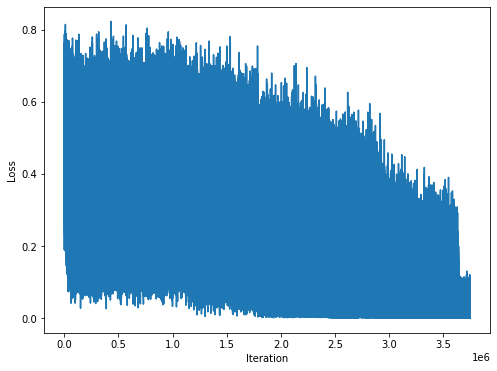

(8000,)
(8000,)


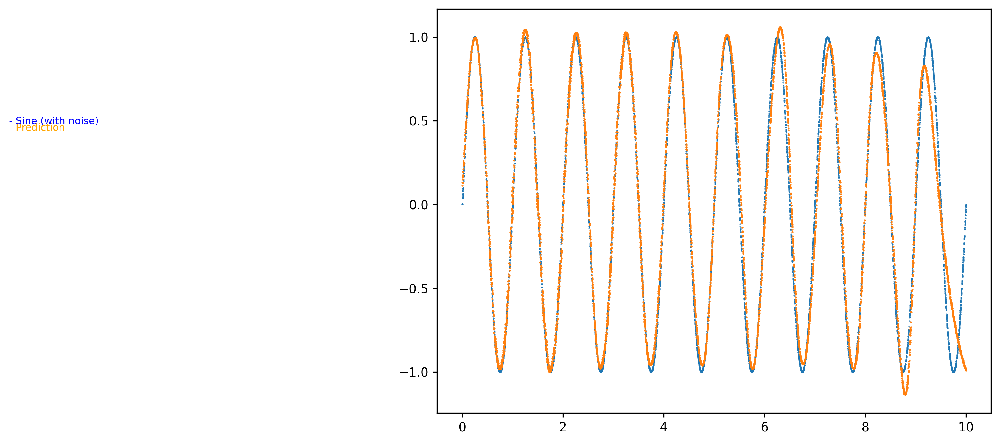

(8000,)
(8000,)


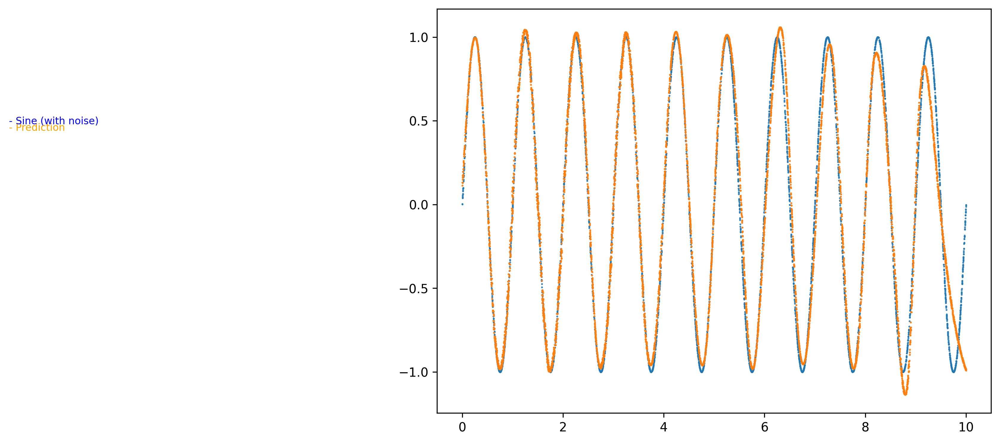

(8000,)
(8000,)


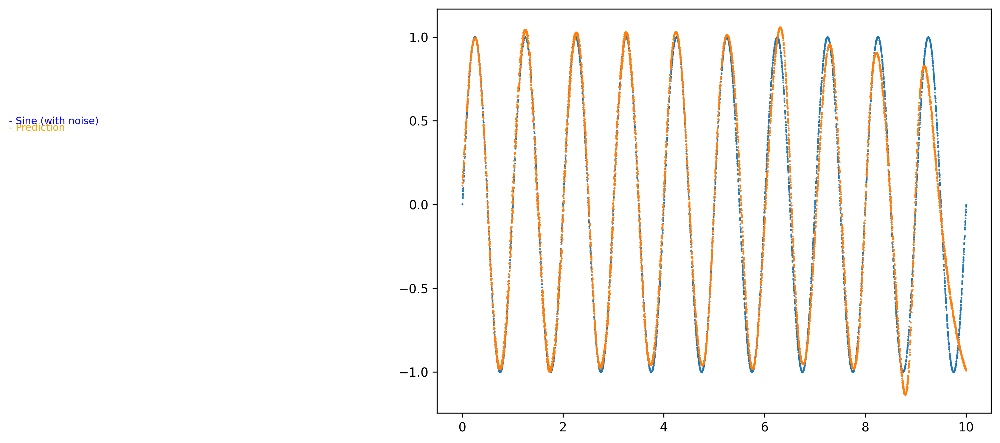

(8000,)
(8000,)


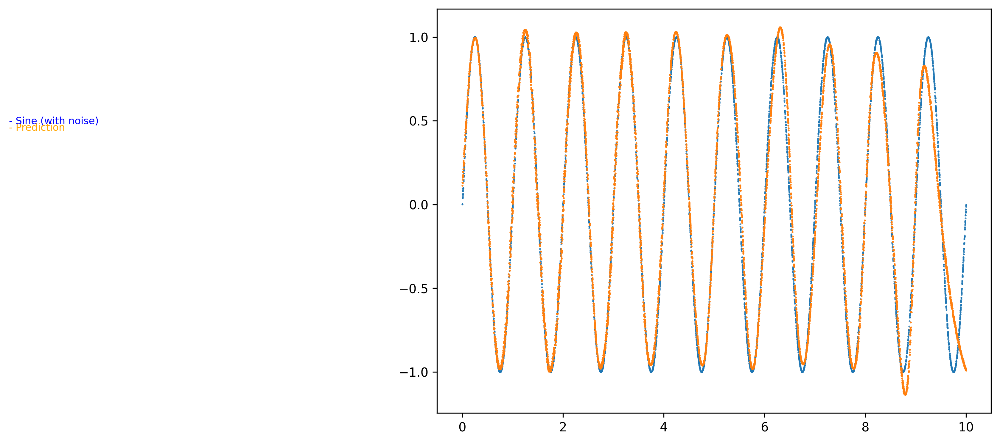

(8000,)
(8000,)


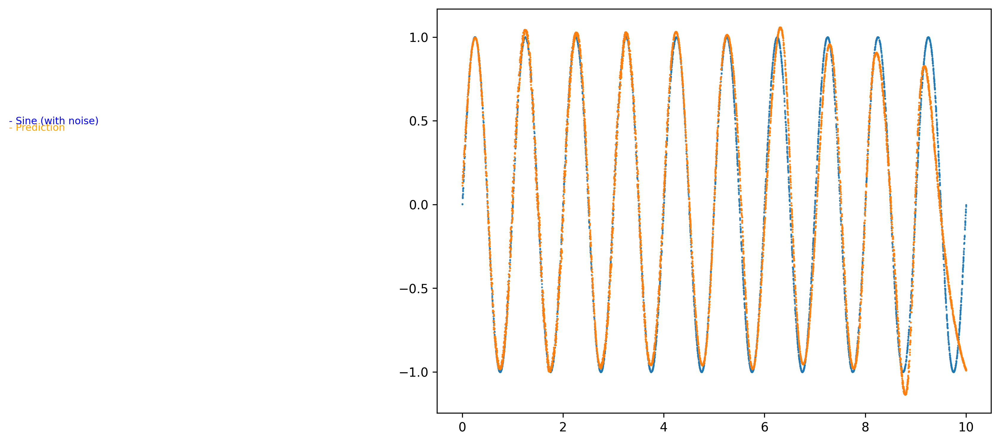

(8000,)
(8000,)


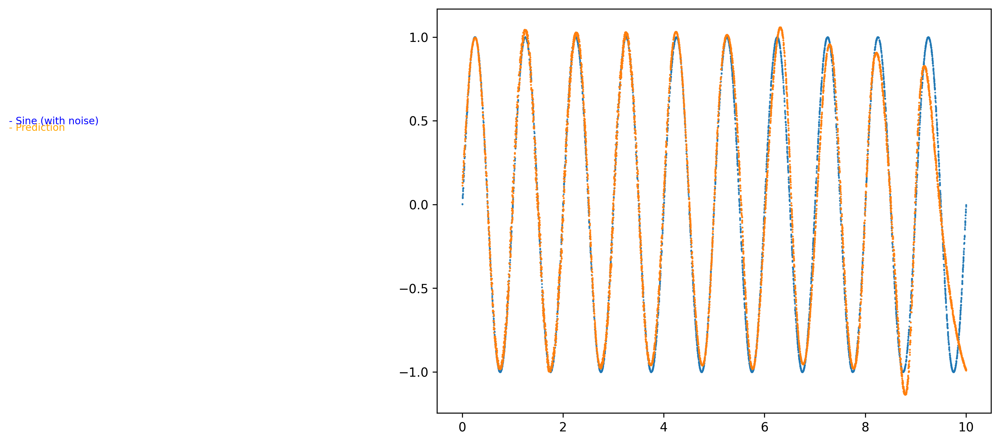

(8000,)
(8000,)


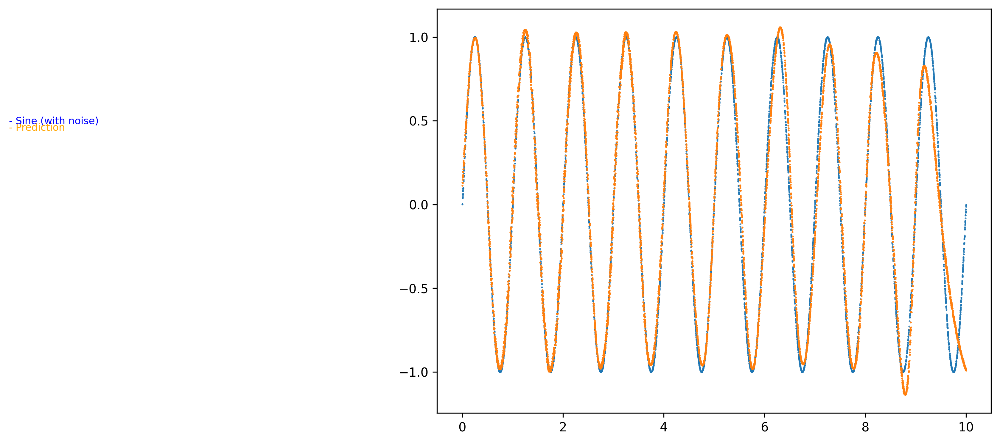

(8000,)
(8000,)


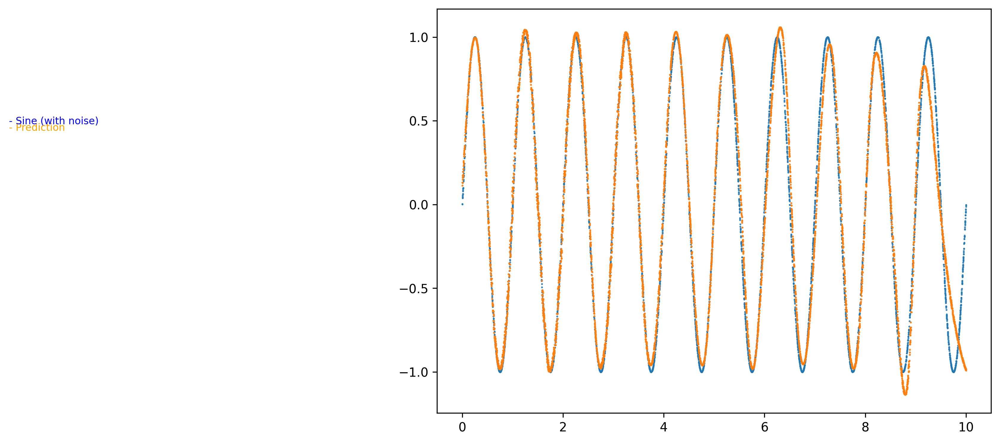

(8000,)
(8000,)


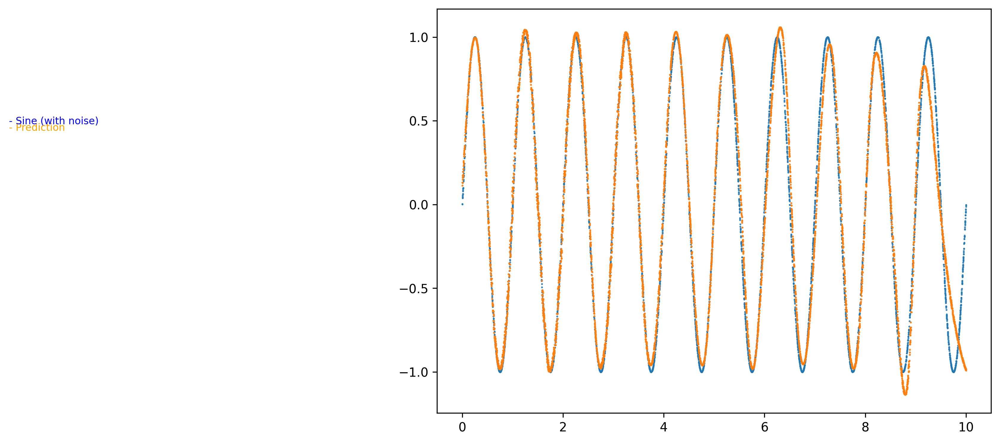

(8000,)
(8000,)


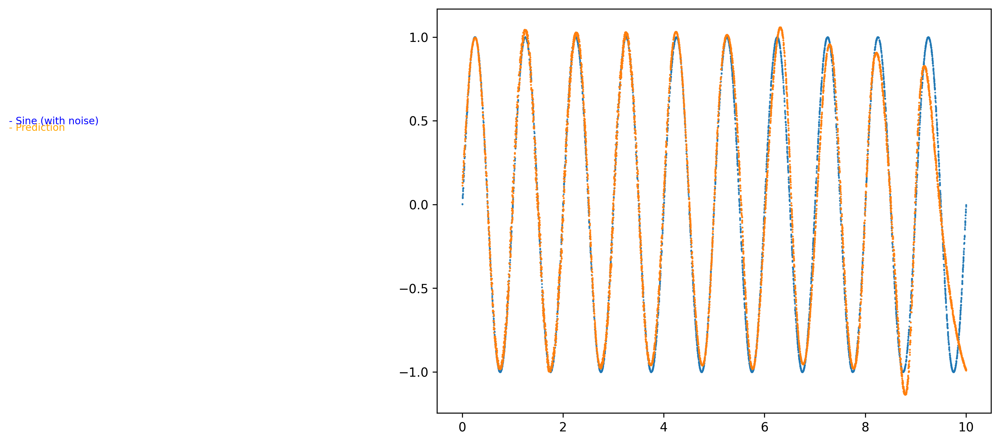

(8000,)
(8000,)


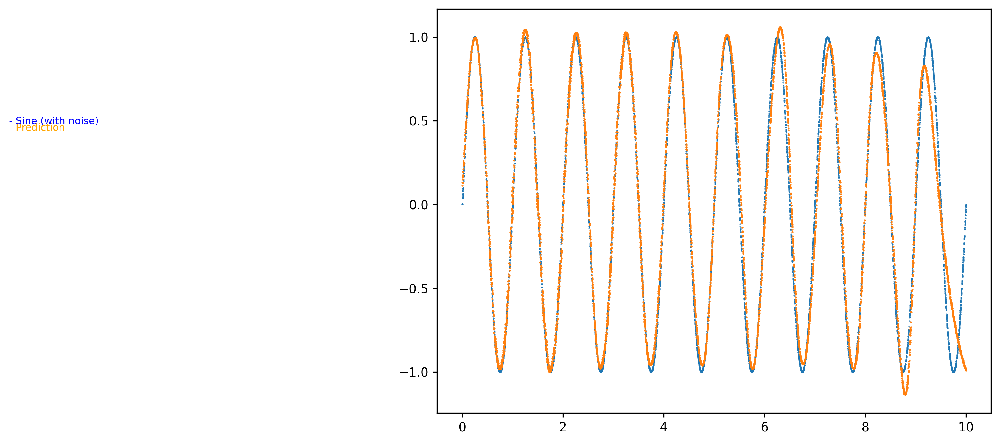

(8000,)
(8000,)


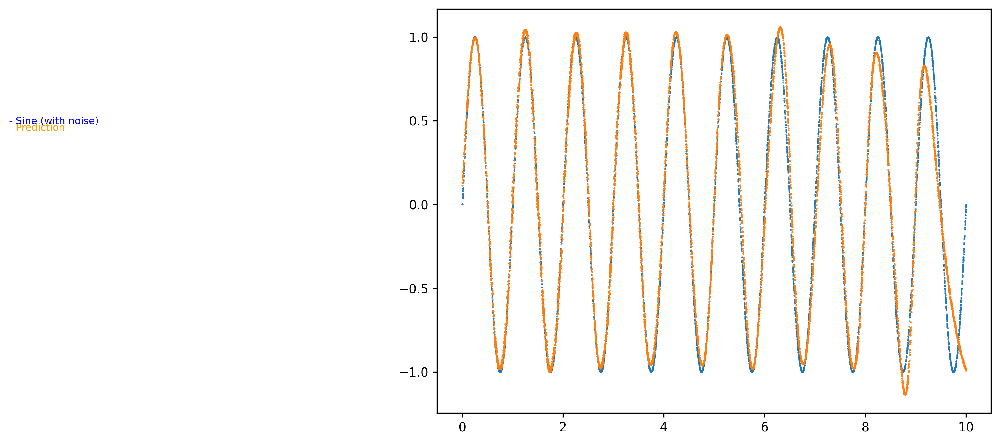

(8000,)
(8000,)


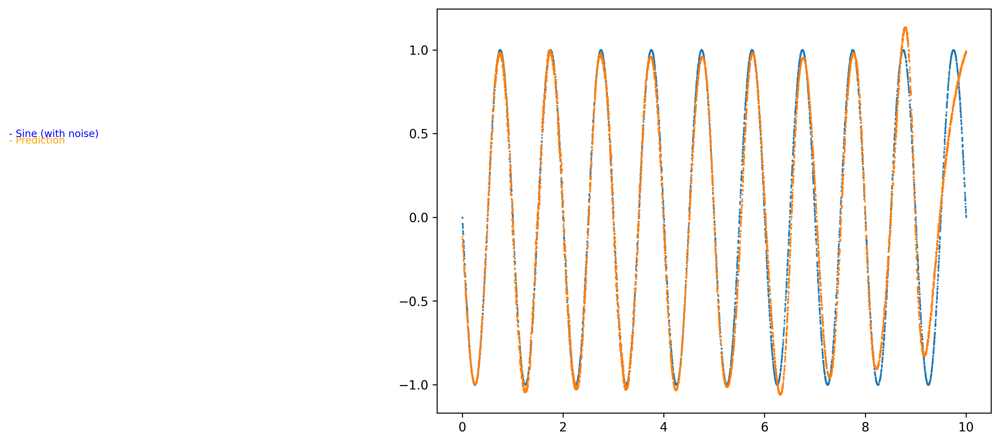

(8000,)
(8000,)


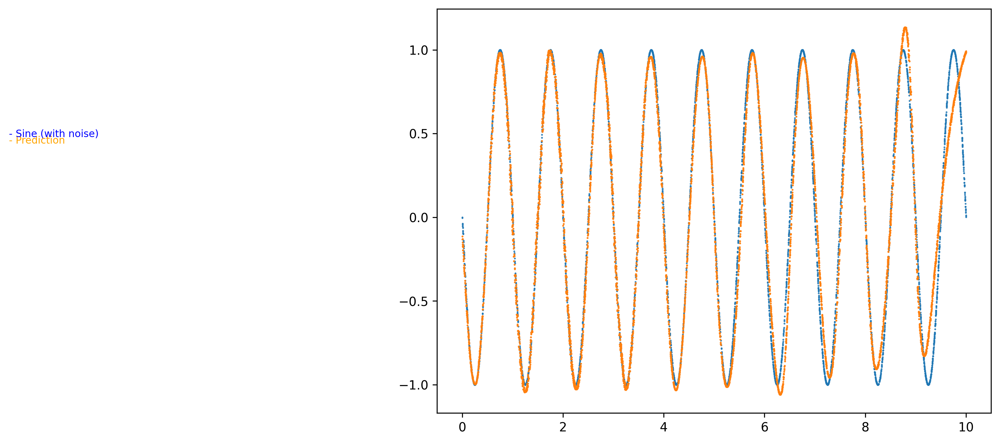

(8000,)
(8000,)


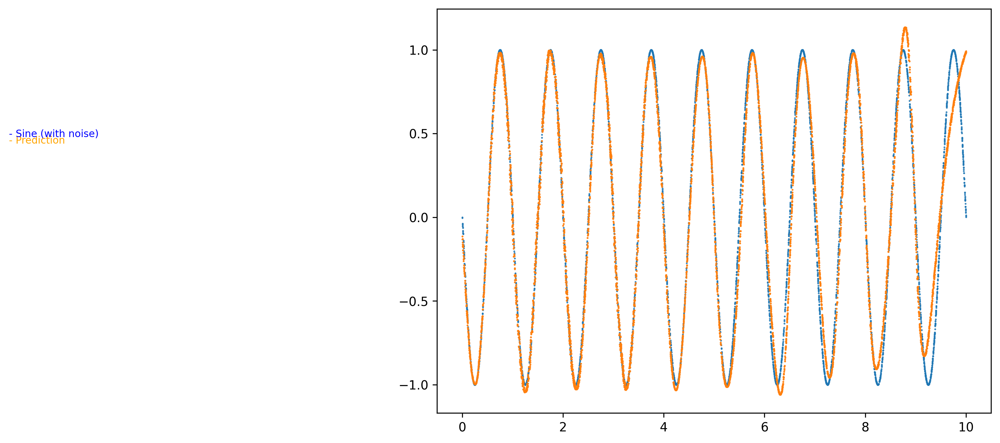

(8000,)
(8000,)


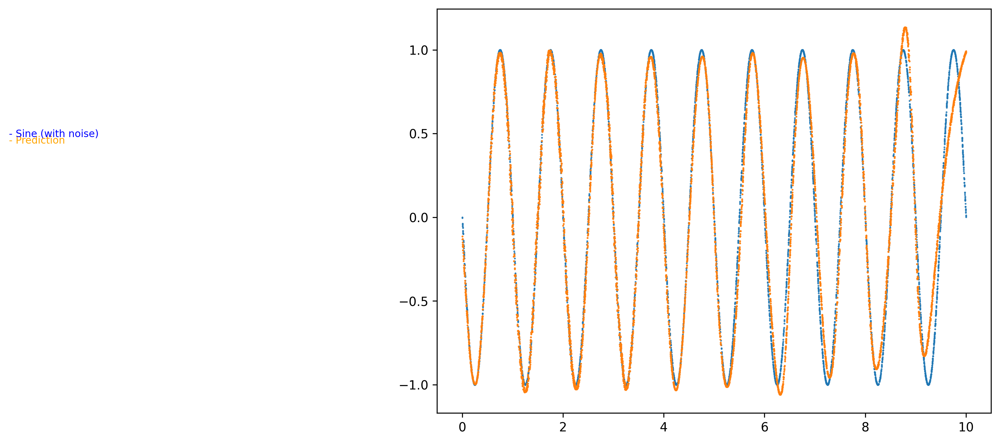

(8000,)
(8000,)


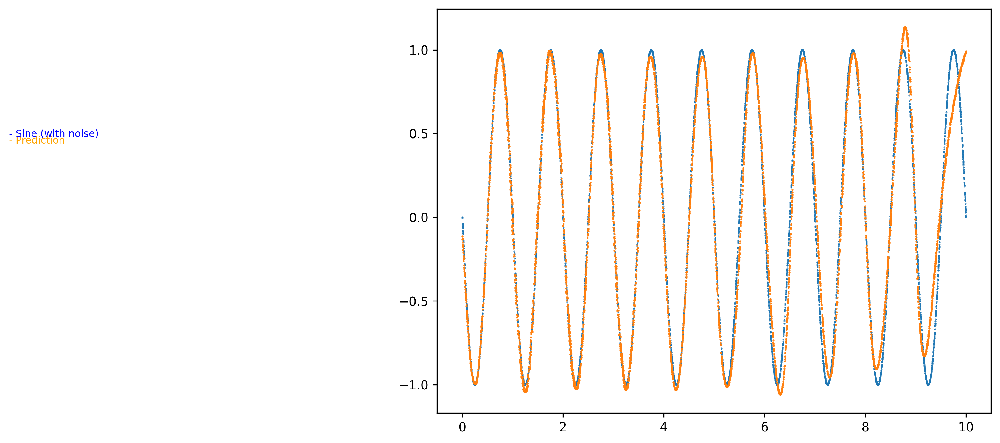

(8000,)
(8000,)


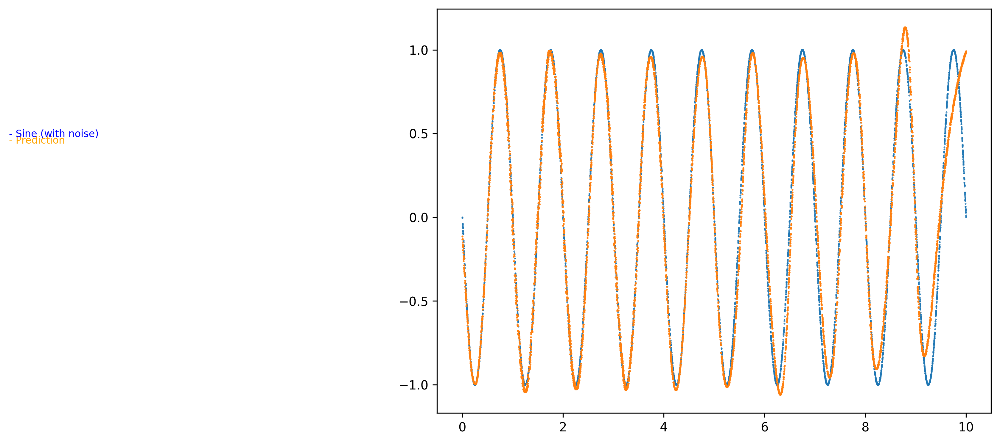

(8000,)
(8000,)


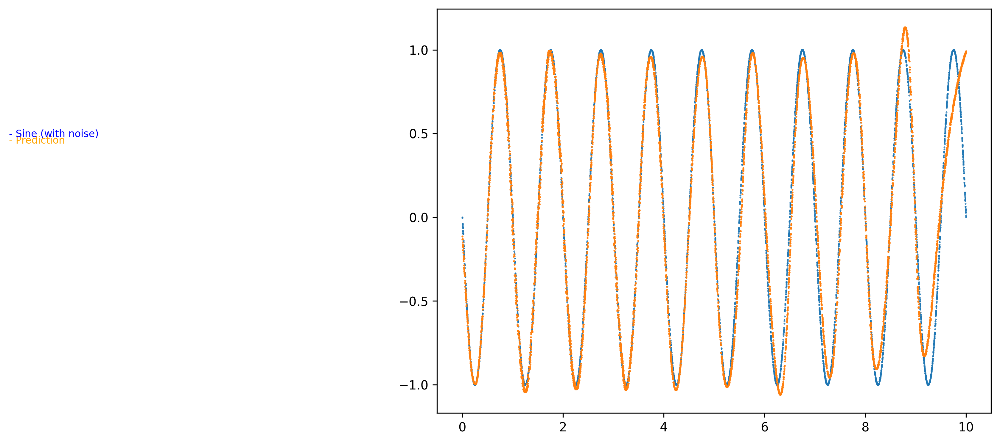

(8000,)
(8000,)


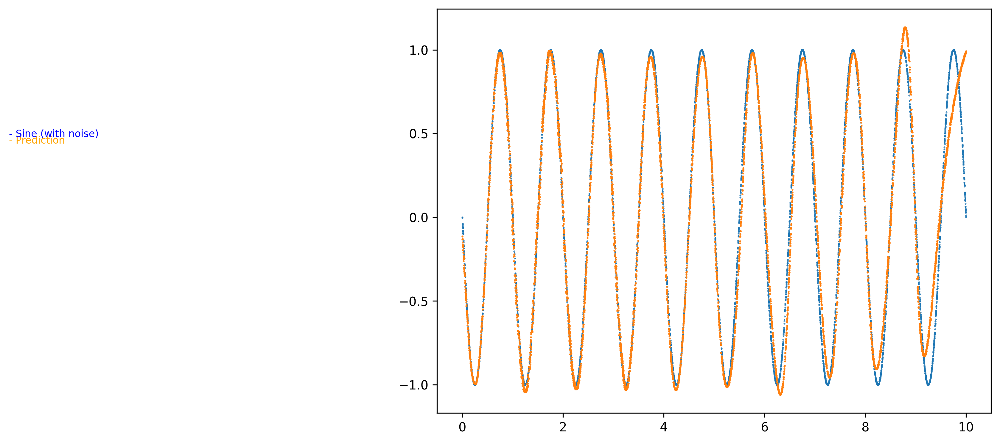

(8000,)
(8000,)


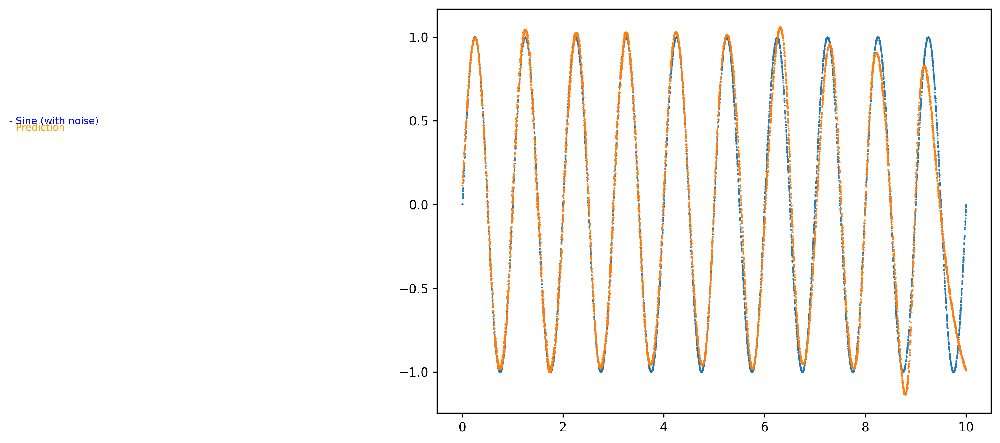

(8000,)
(8000,)


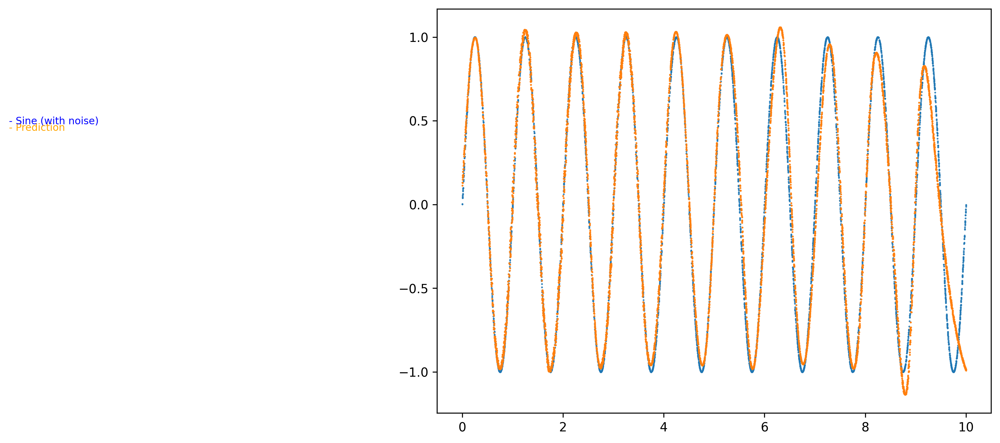

(8000,)
(8000,)


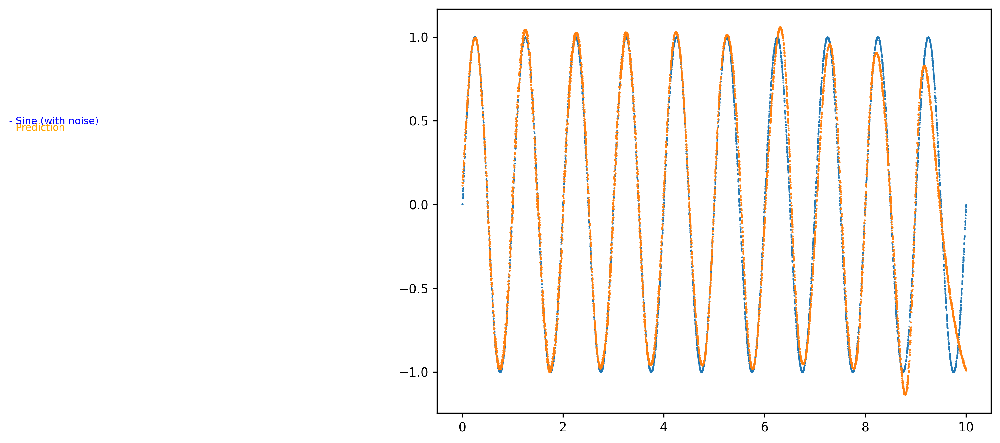

(8000,)
(8000,)


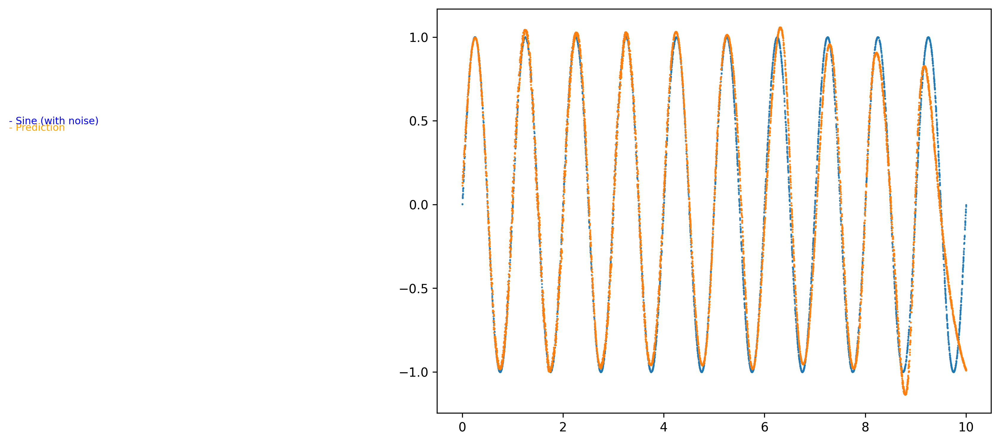

(8000,)
(8000,)


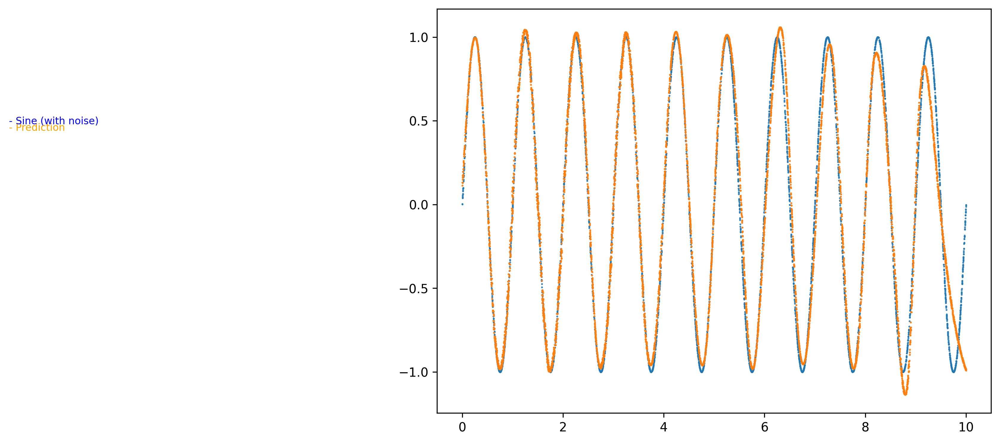

(8000,)
(8000,)


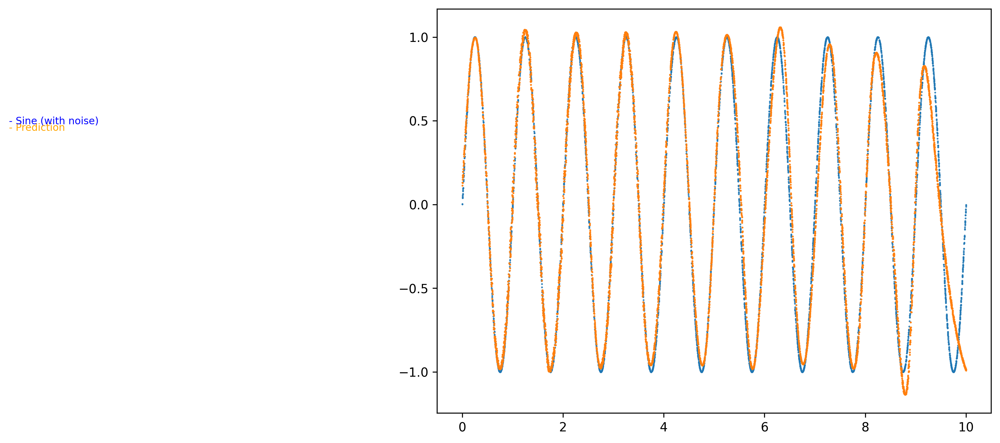

(8000,)
(8000,)


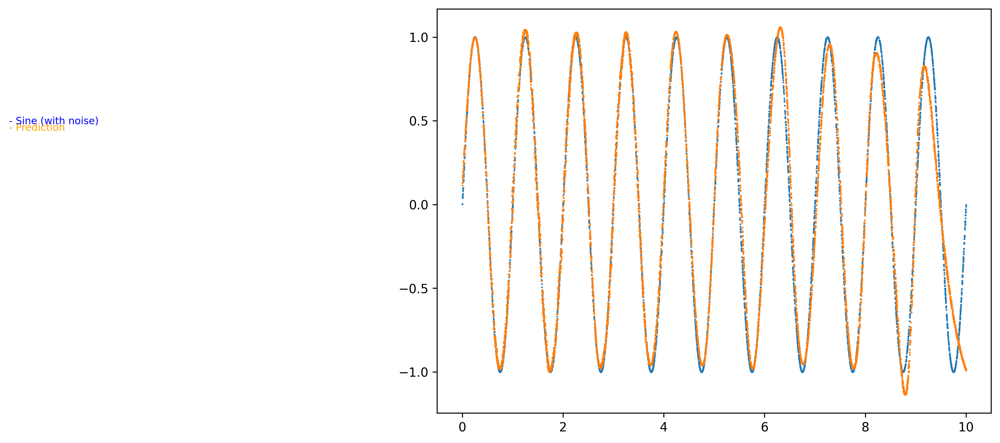

(8000,)
(8000,)


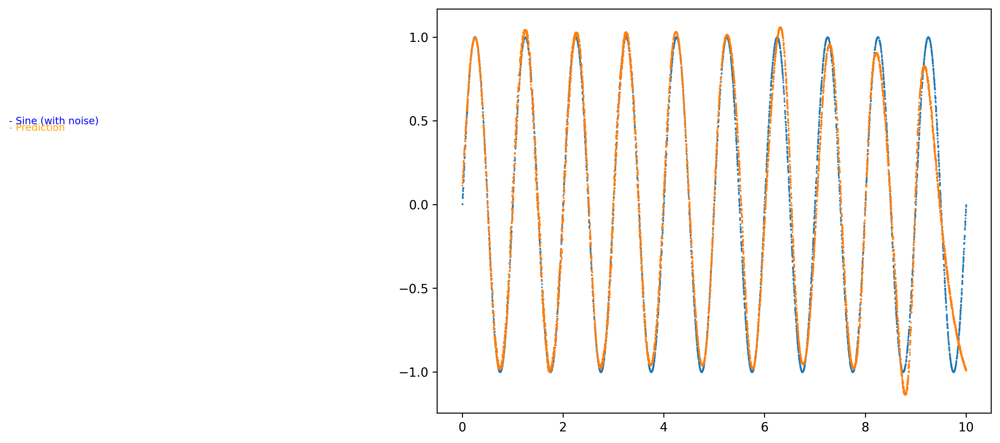

In [ ]:
# Generate a network where the outputs of the ANN are fed back into the inputs on the next timestep.
# Knees are out of phase from hips and lower leg.
# 0 and 1: Spine Joints
# 2 and 3: Front Hip Joints
# 4 and 5: Rear Hip Joints
# 6 and 7: Front Mid Legs
# 8 and 9: Rear Mid Legs
# 10 and 11: Front Lower Legs
# 12 and 13: Rear Lower Legs
phase_offsets = [0,0] # Spine
phase_offsets += [0,0,0,0] # Front and Rear Hip Joints
phase_offsets += [4,4,4,4] # Front and Rear Knee Joints
phase_offsets += [0,0,0,0] # Front and Rear Ankle Joints
x_train, y_train, x_test, y_test = gen_train_and_test_data(33, 28, phase_offset=[(np.pi * phase_offsets[i//2])/4.0 for i in range(28)], joint_outputs_to_input=True, for_back_only=False)

ic(type(x_train))
ic(type(y_train))
ic(type(x_test))
ic(type(y_test))

ic(np.shape(x_train))
ic(np.shape(y_train))

dataset_train = SineDataset(x=x_train, y=y_train)
dataset_test = SineDataset(x=x_test, y=y_test)

ic("Train set size: ", dataset_train.length)
ic("Test set size: ", dataset_test.length)

losses, y_predict, model = run(dataset_train=dataset_train, dataset_test=dataset_test, epochs=2000)

ic("Final loss:", sum(losses[-100:])/100)
plot_loss(losses)


y_test = y_test.transpose()
y_predict = y_predict.transpose()

for yt, yp in zip(y_test, y_predict):
  x_data = x_test.transpose()[0]
  ic(np.shape(x_data))
  ic(np.shape(yt))
  #ic(x_test.shape())
  fig2 = pyplot.figure(dpi=300)
  fig2.set_size_inches(8,6)
  pyplot.scatter(x_data, yt, marker='o', s=0.2)
  pyplot.scatter(x_data, yp, marker='o', s=0.3)
  pyplot.text(-9, 0.44, "- Prediction", color="orange", fontsize=8)
  pyplot.text(-9, 0.48, "- Sine (with noise)", color="blue", fontsize=8)
  pyplot.show()

In [ ]:
#from google.colab import drive
#drive.mount('/content/gdrive')

model_save_name = 'sine_knees_one_phase_offset_random_touch_inputs_time_delay_1_joint_inputs.pt'
path = F"/content/gdrive/My Drive/{model_save_name}" 
torch.save(model.state_dict(), path)

(33, 30000)
(30000, 33)
(30000, 28)
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(30000, 33)
(30000, 28)
Train set size:  30000
Test set size:  8000
Epoch:  1
Batches:  1875
Epoch:  51
Batches:  95625
Epoch:  101
Batches:  189375
Epoch:  151
Batches:  283125
Epoch:  201
Batches:  376875
Epoch:  251
Batches:  470625
Epoch:  301
Batches:  564375
Epoch:  351
Batches:  658125
Epoch:  401
Batches:  751875
Epoch:  451
Batches:  845625
Epoch:  501
Batches:  939375
Epoch:  551
Batches:  1033125
Epoch:  601
Batches:  1126875
Epoch:  651
Batches:  1220625
Epoch:  701
Batches:  1314375
Epoch:  751
Batches:  1408125
Epoch:  801
Batches:  1501875
Epoch:  851
Batches:  1595625
Epoch:  901
Batches:  1689375
Epoch:  951
Batches:  1783125
Epoch:  1001
Batches:  1876875
Epoch:  1051
Batches:  1970625
Epoch:  1101
Batches:  2064375
Epoch:  1151
Batches:  2158125
Epoch:  1201
Batches:  2251875
Epoch:  1251
Batches:  2345625
Epoch:  1301
Batches:  2439375


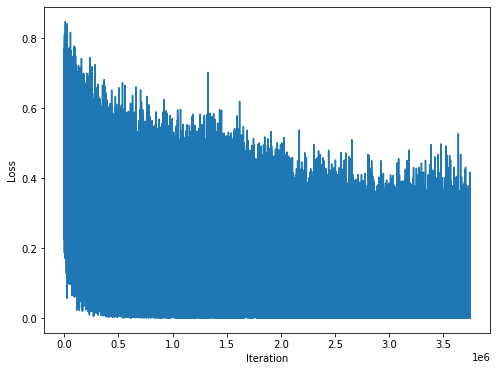

(8000,)
(8000,)


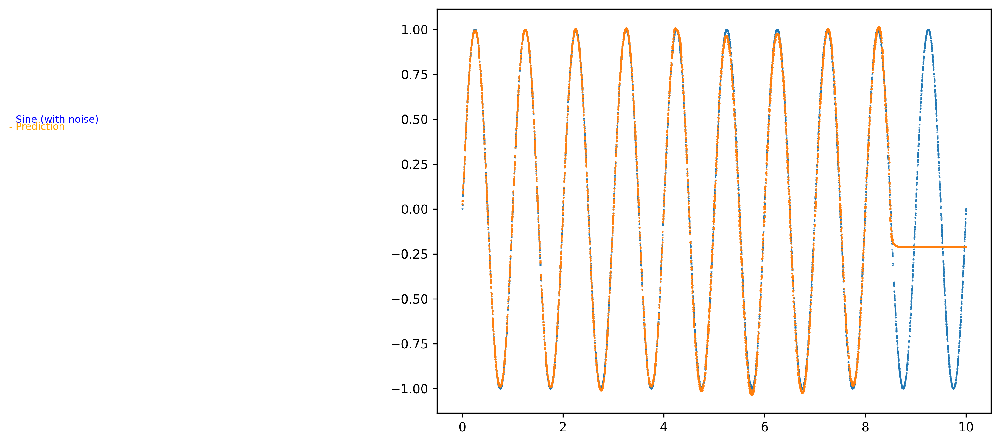

(8000,)
(8000,)


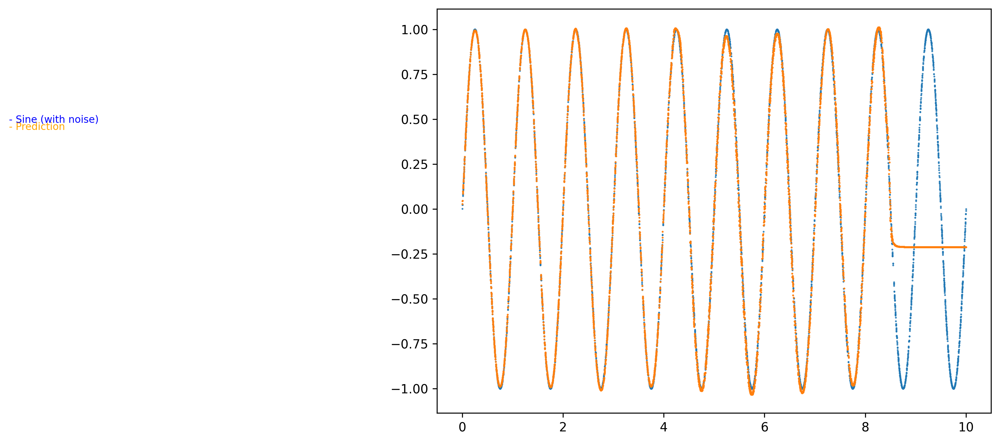

(8000,)
(8000,)


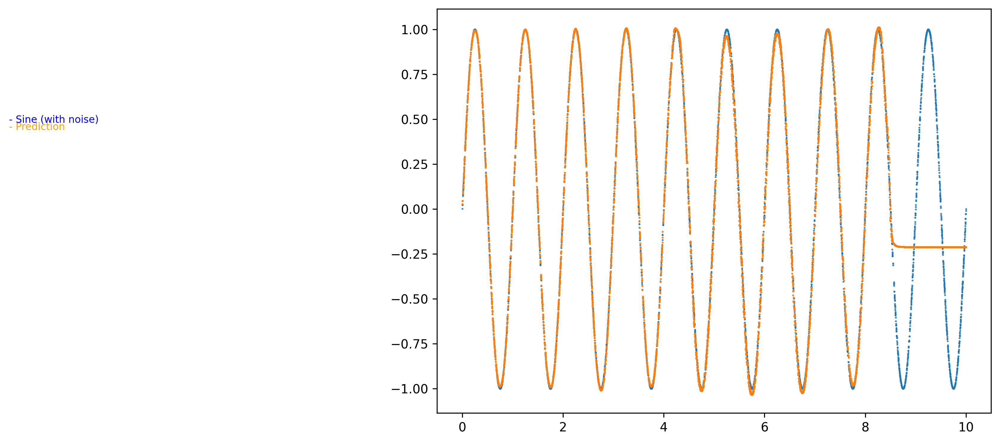

(8000,)
(8000,)


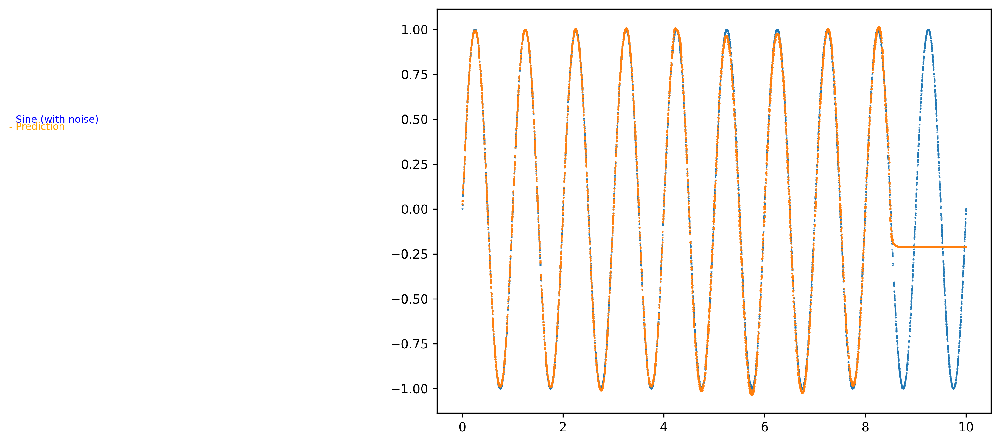

(8000,)
(8000,)


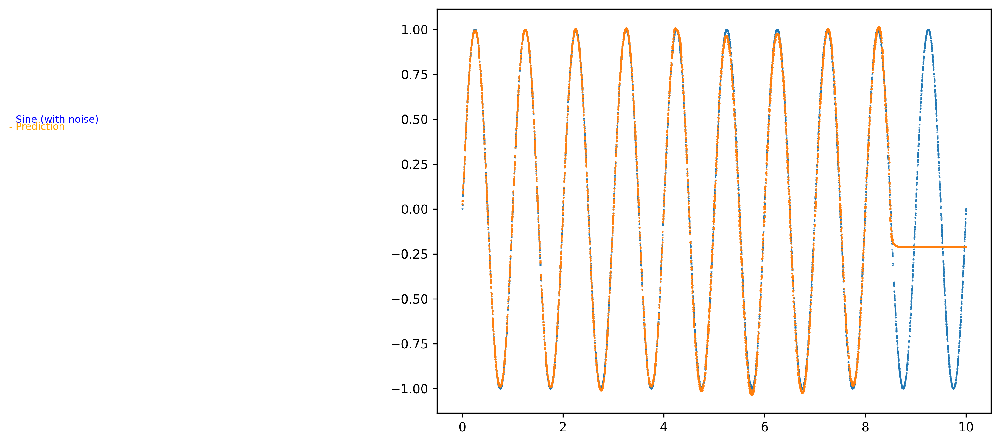

(8000,)
(8000,)


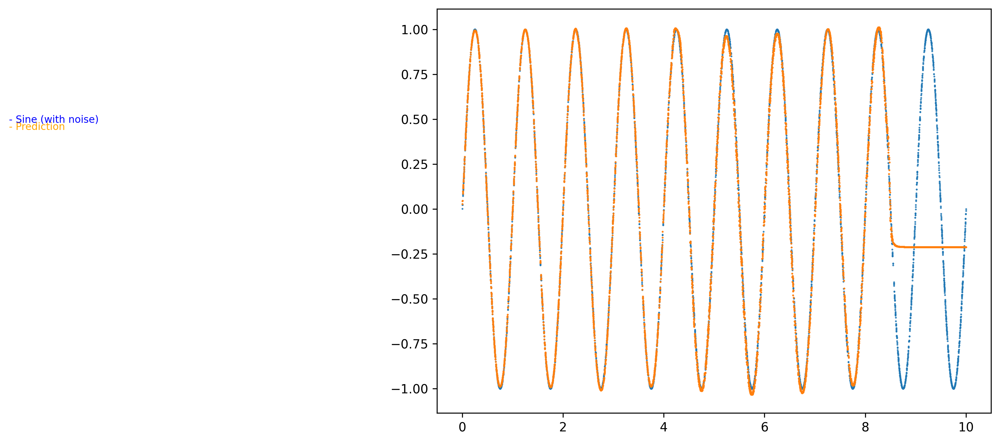

(8000,)
(8000,)


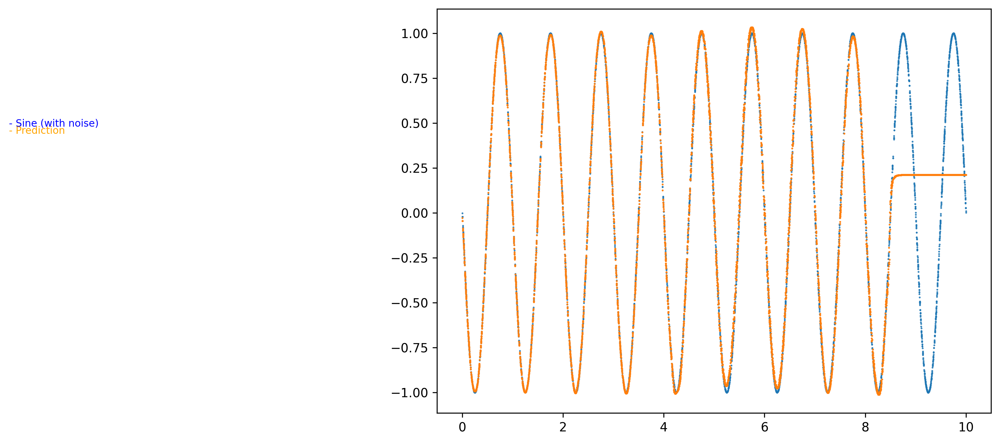

(8000,)
(8000,)


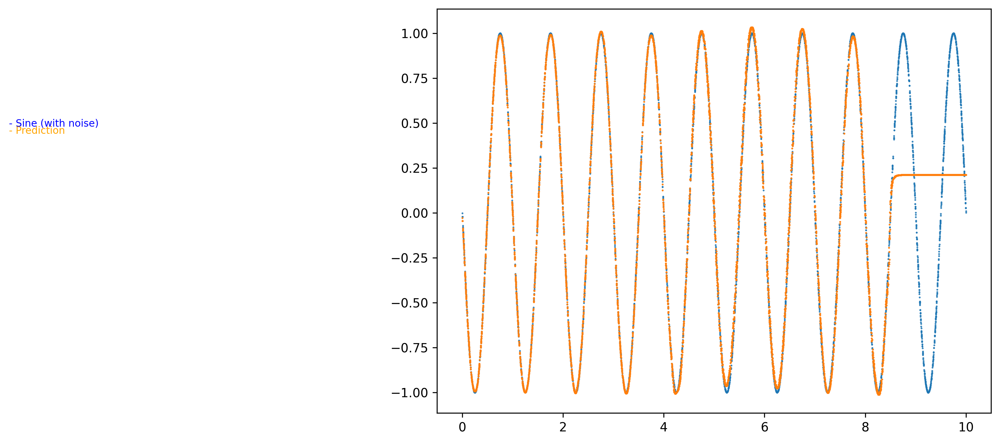

(8000,)
(8000,)


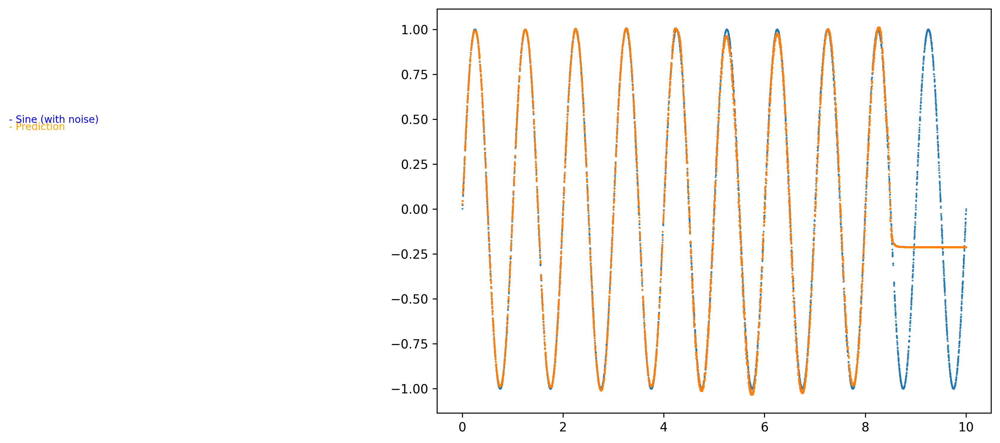

(8000,)
(8000,)


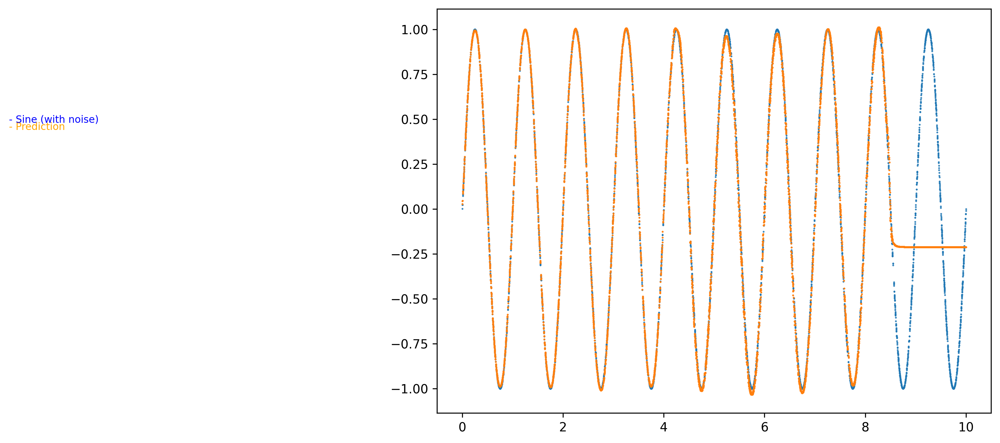

(8000,)
(8000,)


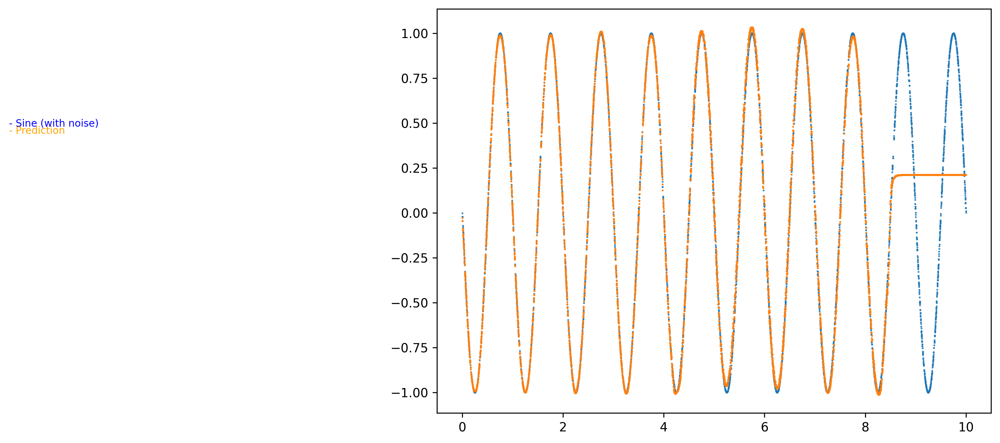

(8000,)
(8000,)


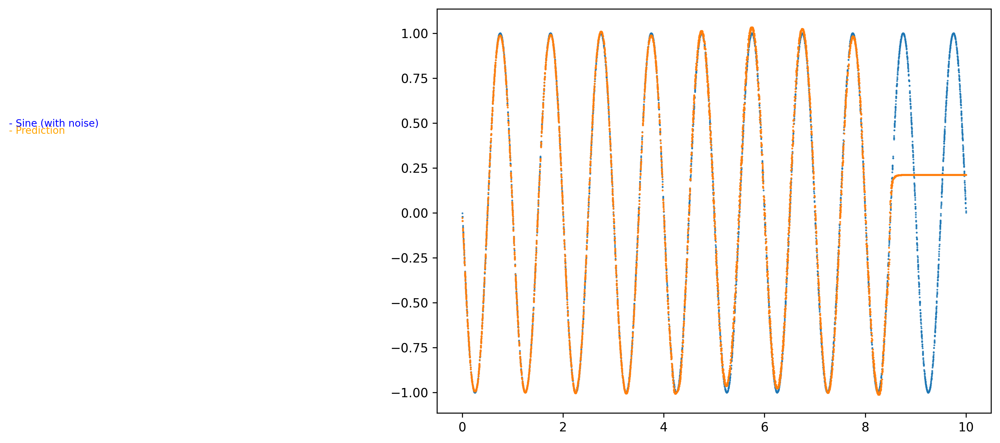

(8000,)
(8000,)


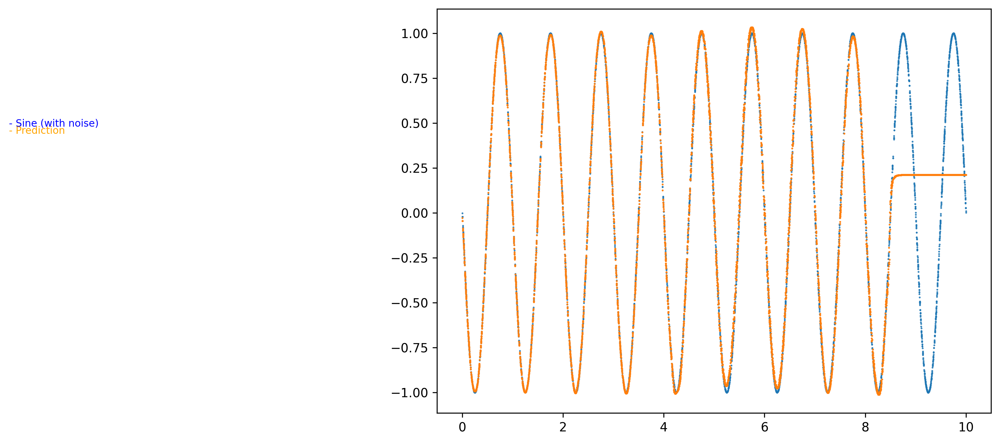

(8000,)
(8000,)


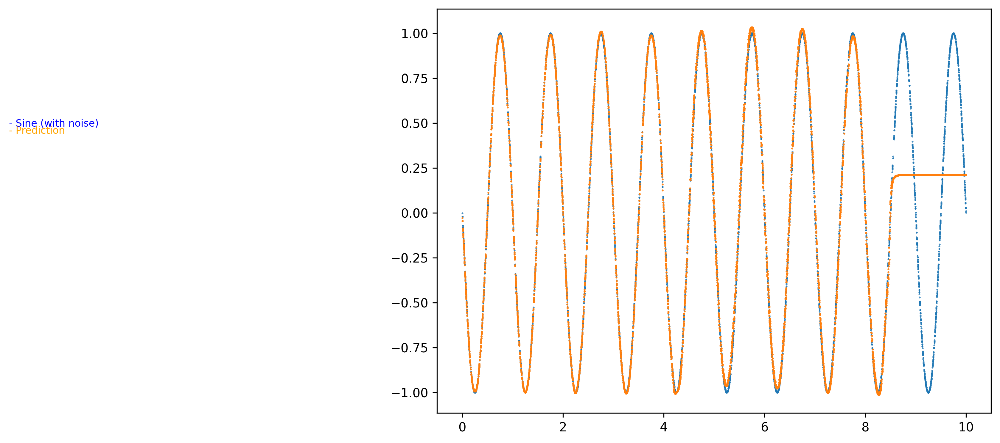

(8000,)
(8000,)


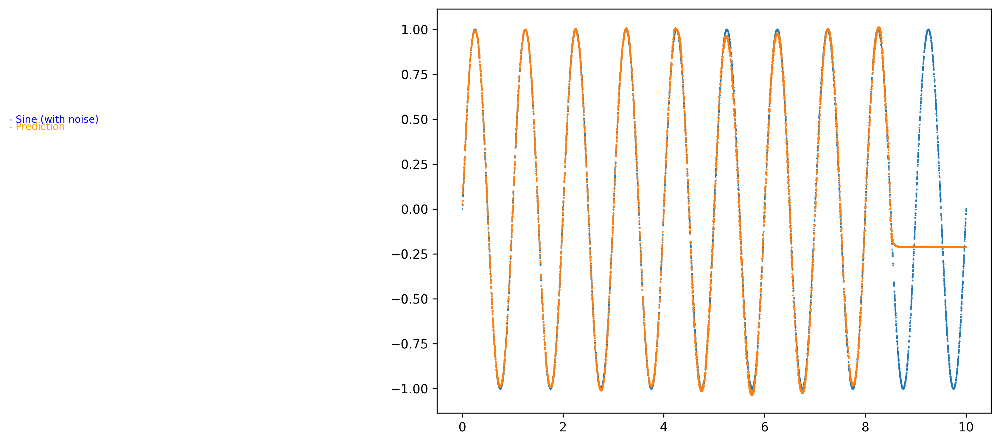

(8000,)
(8000,)


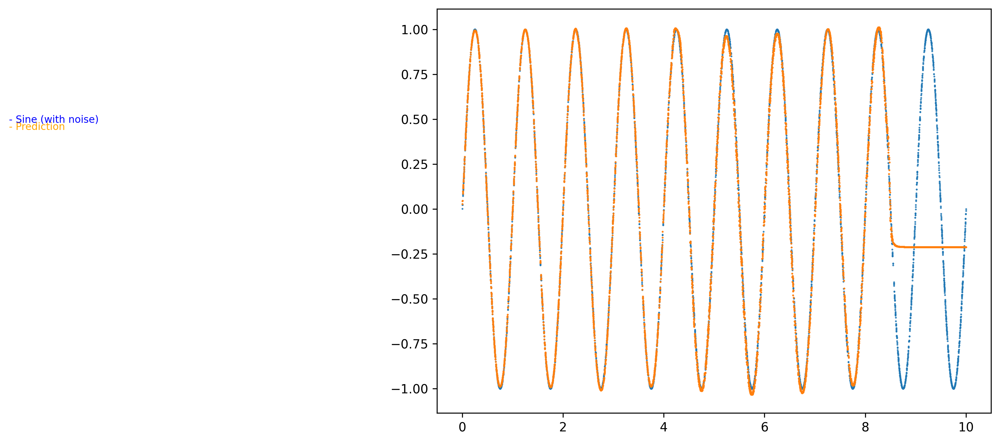

(8000,)
(8000,)


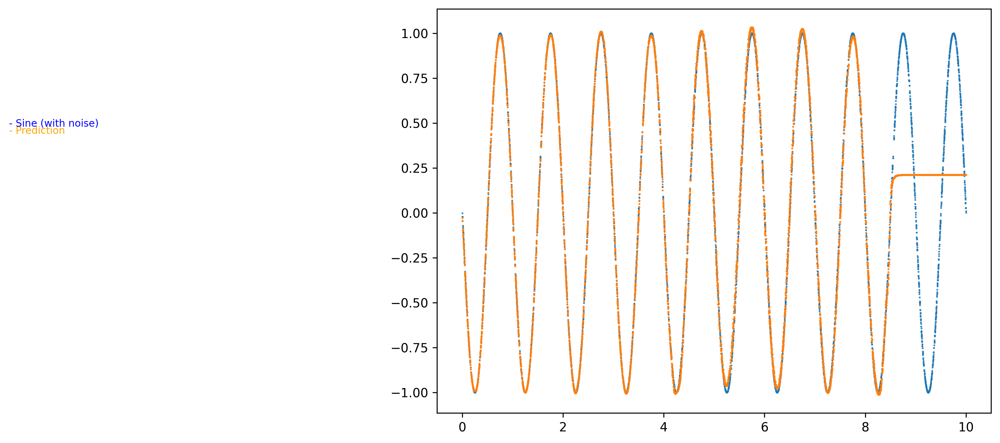

(8000,)
(8000,)


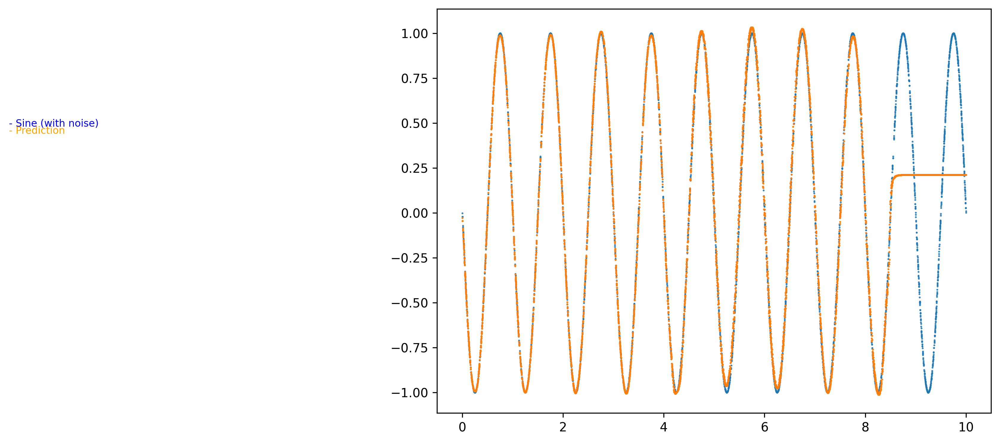

(8000,)
(8000,)


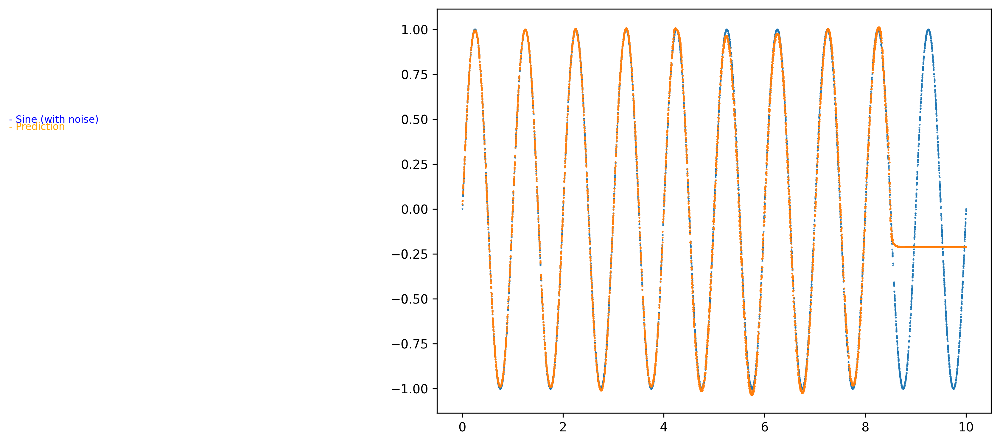

(8000,)
(8000,)


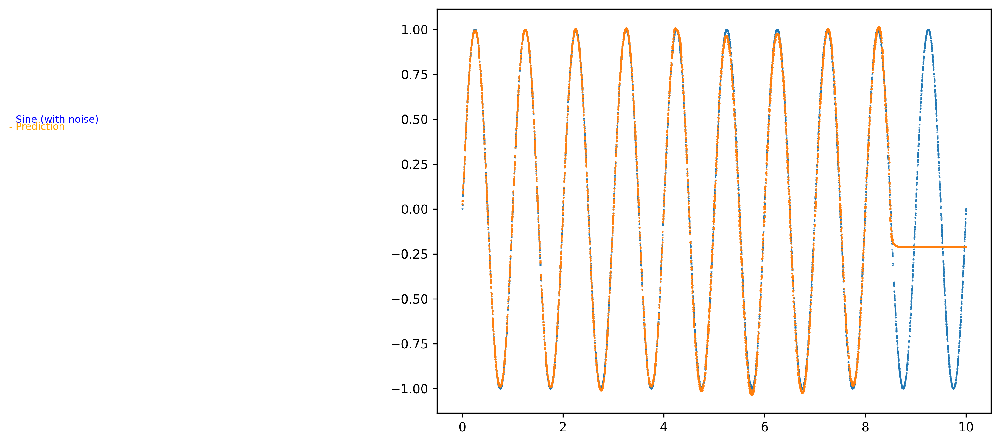

(8000,)
(8000,)


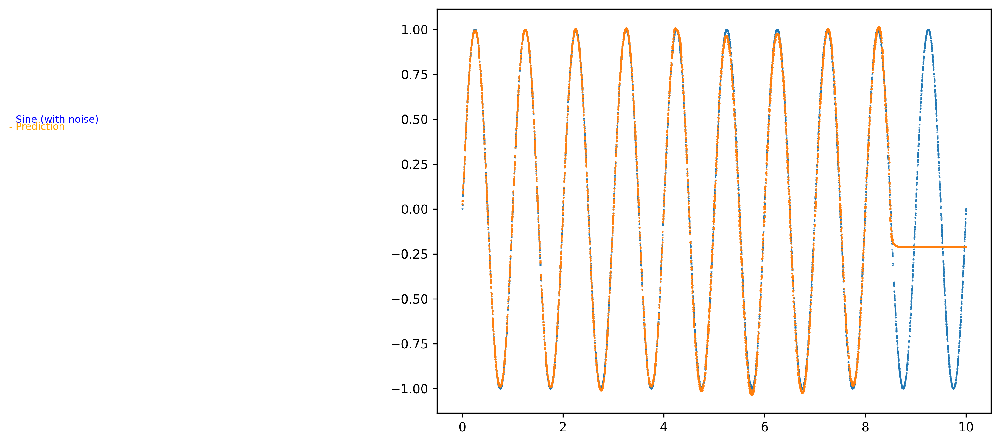

(8000,)
(8000,)


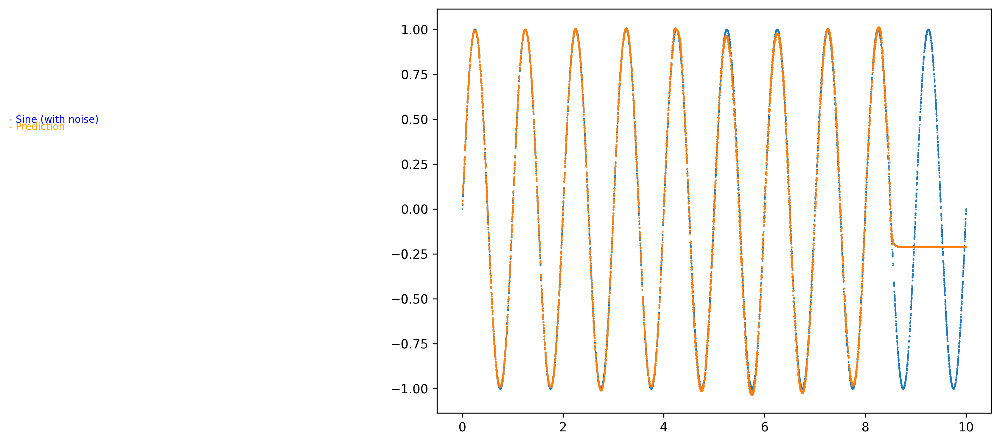

(8000,)
(8000,)


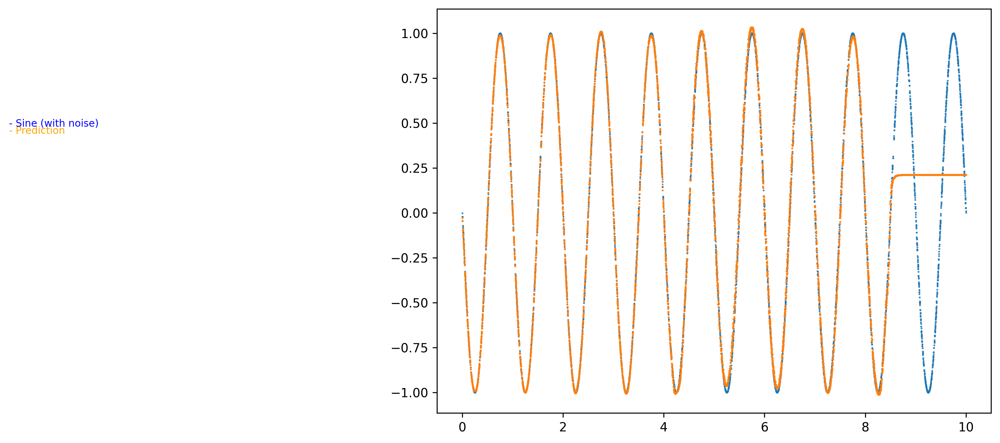

(8000,)
(8000,)


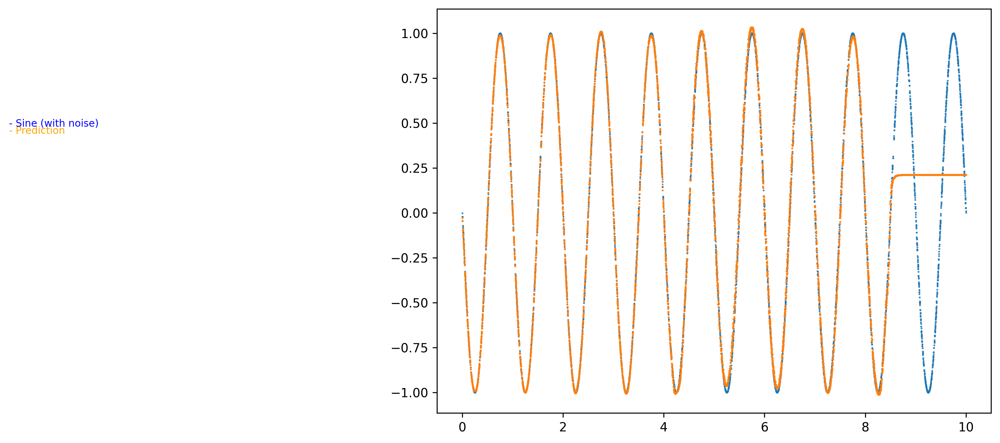

(8000,)
(8000,)


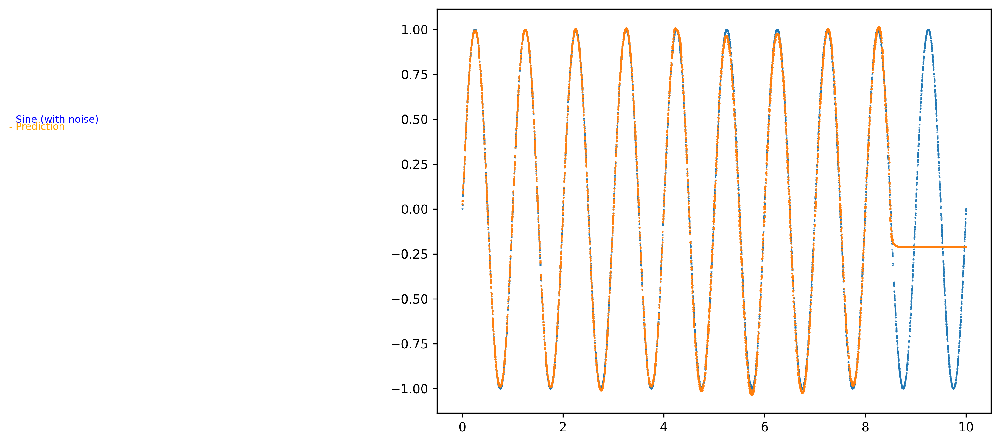

(8000,)
(8000,)


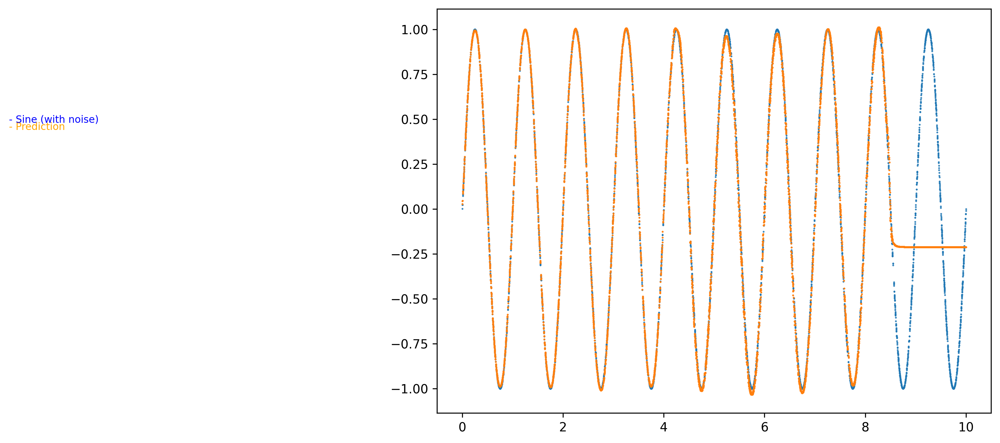

(8000,)
(8000,)


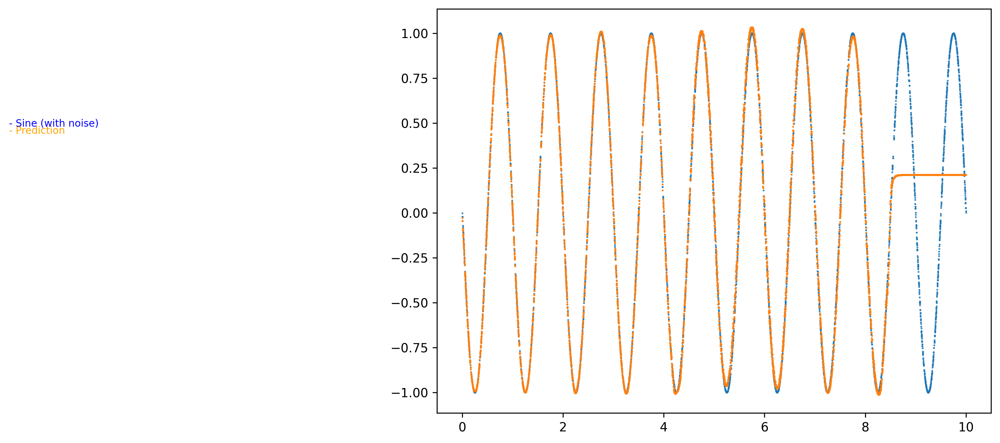

(8000,)
(8000,)


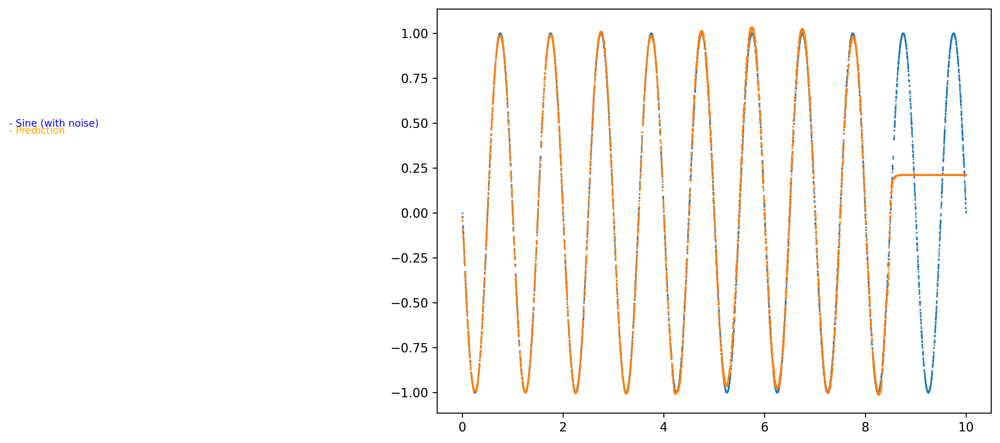

In [ ]:
# Generate a network where the outputs of the ANN are fed back into the inputs on the next timestep.
# Knees are out of phase from hips and lower leg.
# Hips are diagonally coordinated
# 0 and 1: Spine Joints
# 2 and 3: Front Hip Joints
# 4 and 5: Rear Hip Joints
# 6 and 7: Front Mid Legs
# 8 and 9: Rear Mid Legs
# 10 and 11: Front Lower Legs
# 12 and 13: Rear Lower Legs
phase_offsets = [0,0] # Spine
phase_offsets += [0,4,0,4] # Front and Rear Hip Joints
phase_offsets += [4,0,4,0] # Front and Rear Knee Joints
phase_offsets += [0,4,0,4] # Front and Rear Ankle Joints
x_train, y_train, x_test, y_test = gen_train_and_test_data(33, 28, phase_offset=[(np.pi * phase_offsets[i//2])/4.0 for i in range(28)], joint_outputs_to_input=True, for_back_only=False)

ic(type(x_train))
ic(type(y_train))
ic(type(x_test))
ic(type(y_test))

ic(np.shape(x_train))
ic(np.shape(y_train))

dataset_train = SineDataset(x=x_train, y=y_train)
dataset_test = SineDataset(x=x_test, y=y_test)

ic("Train set size: ", dataset_train.length)
ic("Test set size: ", dataset_test.length)

losses, y_predict, model = run(dataset_train=dataset_train, dataset_test=dataset_test, epochs=2000)

ic("Final loss:", sum(losses[-100:])/100)
plot_loss(losses)


y_test = y_test.transpose()
y_predict = y_predict.transpose()

for yt, yp in zip(y_test, y_predict):
  x_data = x_test.transpose()[0]
  ic(np.shape(x_data))
  ic(np.shape(yt))
  #ic(x_test.shape())
  fig2 = pyplot.figure(dpi=300)
  fig2.set_size_inches(8,6)
  pyplot.scatter(x_data, yt, marker='o', s=0.2)
  pyplot.scatter(x_data, yp, marker='o', s=0.3)
  pyplot.text(-9, 0.44, "- Prediction", color="orange", fontsize=8)
  pyplot.text(-9, 0.48, "- Sine (with noise)", color="blue", fontsize=8)
  pyplot.show()

In [ ]:
#from google.colab import drive
#drive.mount('/content/gdrive')

model_save_name = 'sine_hips_diagonally_coordinated_knees_one_phase_offset_from_hips_random_touch_inputs_time_delay_1_joint_inputs.pt'
path = F"/content/gdrive/My Drive/{model_save_name}" 
torch.save(model.state_dict(), path)

(33, 30000)
(30000, 33)
(30000, 28)
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(30000, 33)
(30000, 28)
Train set size:  30000
Test set size:  8000
Epoch:  1
Batches:  1875
Epoch:  51
Batches:  95625
Epoch:  101
Batches:  189375
Epoch:  151
Batches:  283125
Epoch:  201
Batches:  376875
Epoch:  251
Batches:  470625
Epoch:  301
Batches:  564375
Epoch:  351
Batches:  658125
Epoch:  401
Batches:  751875
Epoch:  451
Batches:  845625
Epoch:  501
Batches:  939375
Epoch:  551
Batches:  1033125
Epoch:  601
Batches:  1126875
Epoch:  651
Batches:  1220625
Epoch:  701
Batches:  1314375
Epoch:  751
Batches:  1408125
Epoch:  801
Batches:  1501875
Epoch:  851
Batches:  1595625
Epoch:  901
Batches:  1689375
Epoch:  951
Batches:  1783125
Epoch:  1001
Batches:  1876875
Epoch:  1051
Batches:  1970625
Epoch:  1101
Batches:  2064375
Epoch:  1151
Batches:  2158125
Epoch:  1201
Batches:  2251875
Epoch:  1251
Batches:  2345625
Epoch:  1301
Batches:  2439375


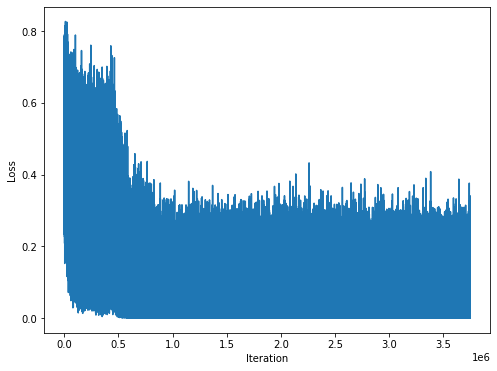

(8000,)
(8000,)


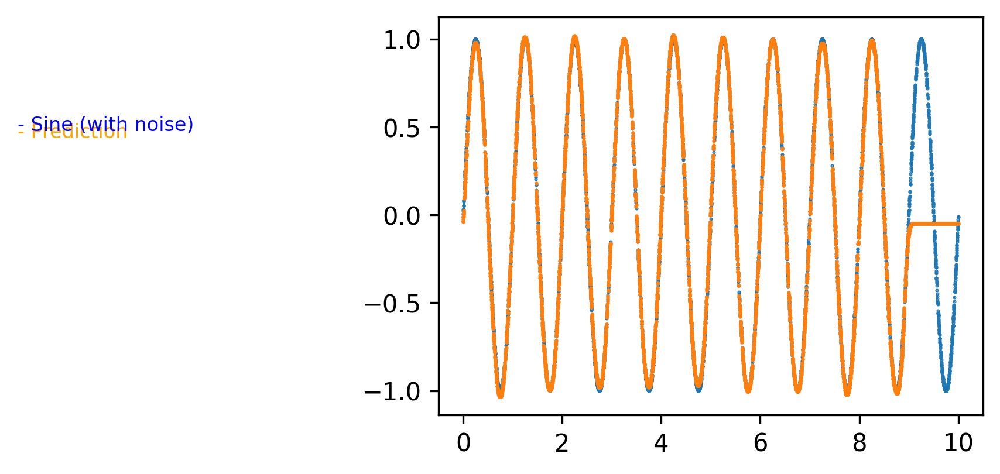

(8000,)
(8000,)


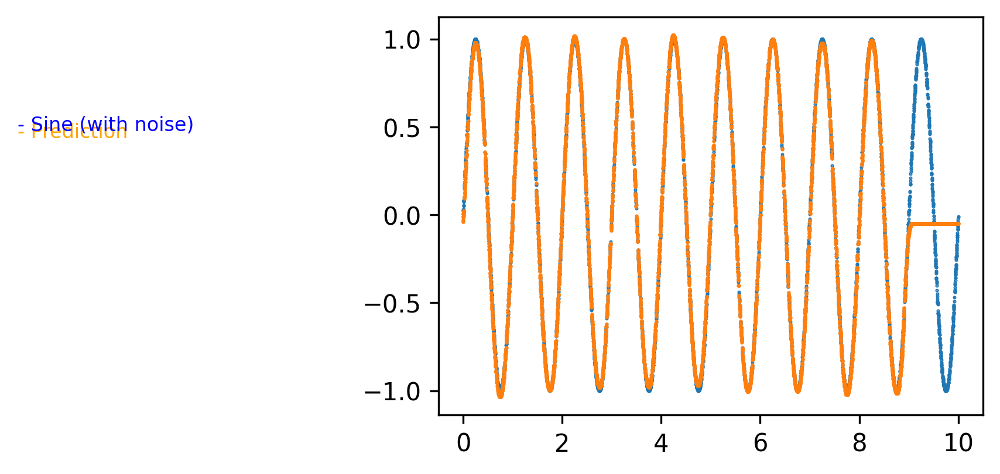

(8000,)
(8000,)


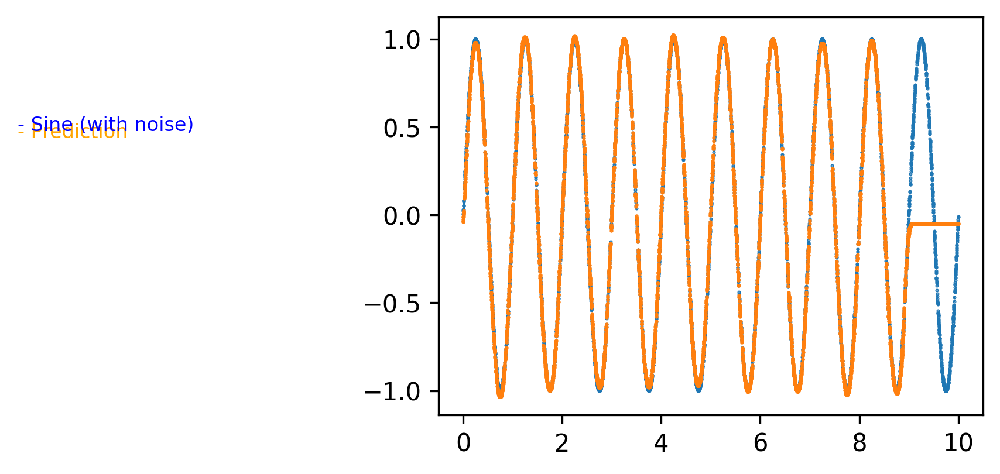

(8000,)
(8000,)


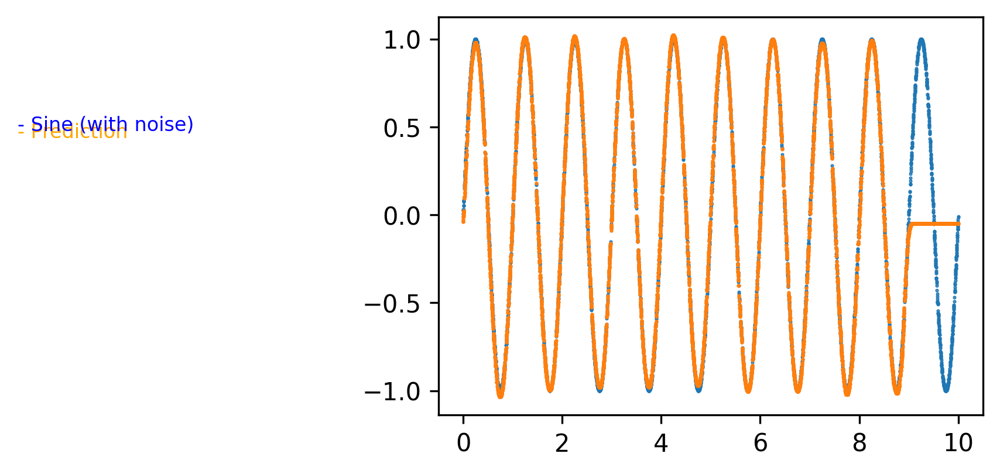

(8000,)
(8000,)


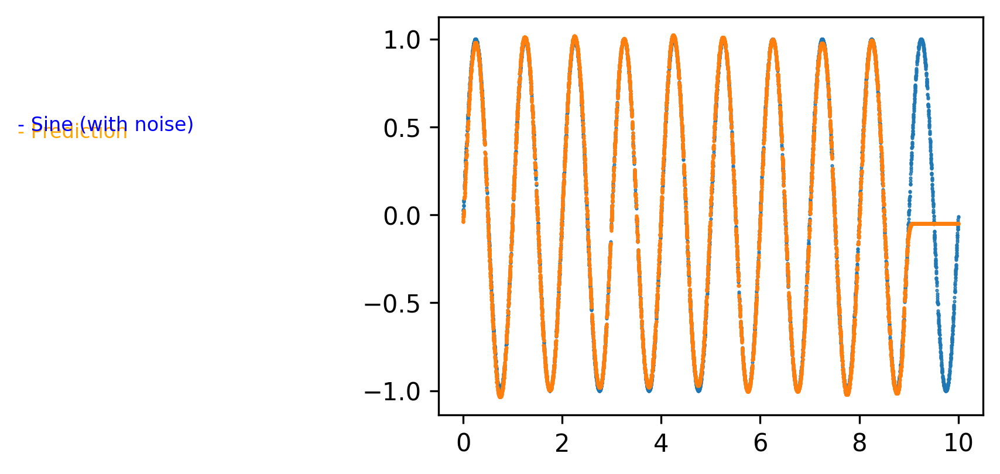

(8000,)
(8000,)


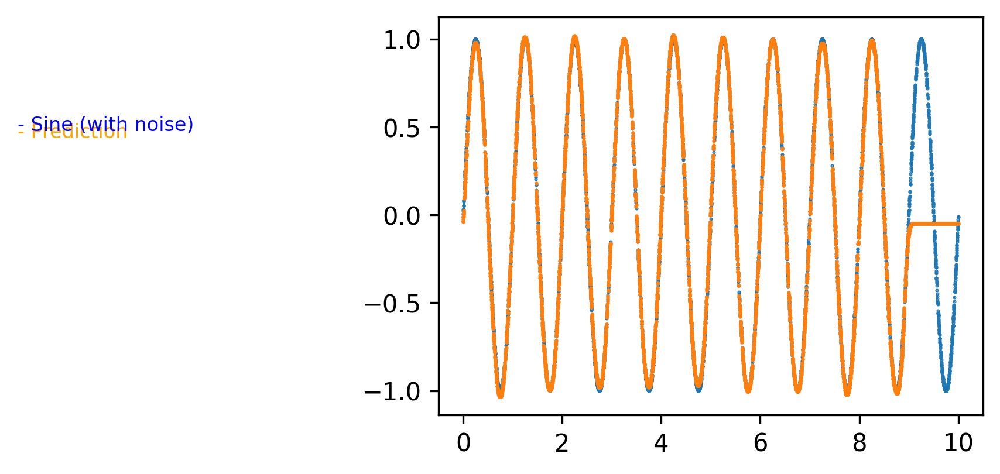

(8000,)
(8000,)


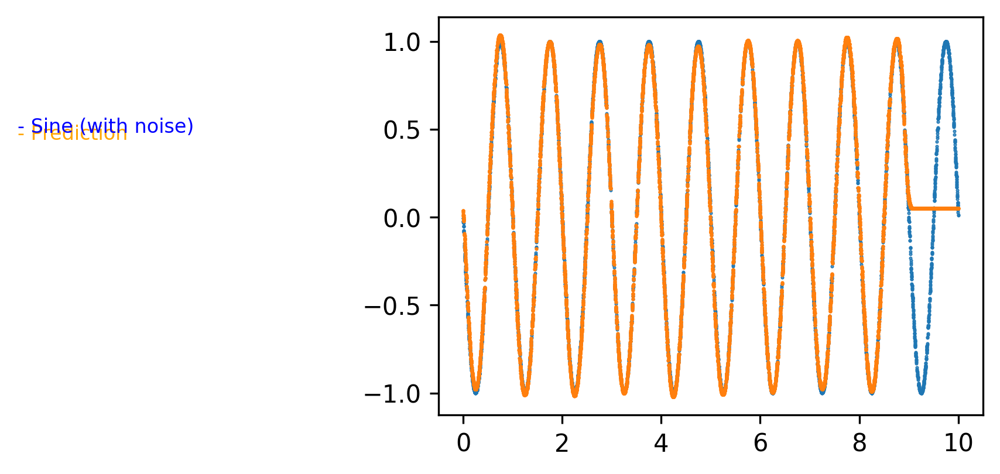

(8000,)
(8000,)


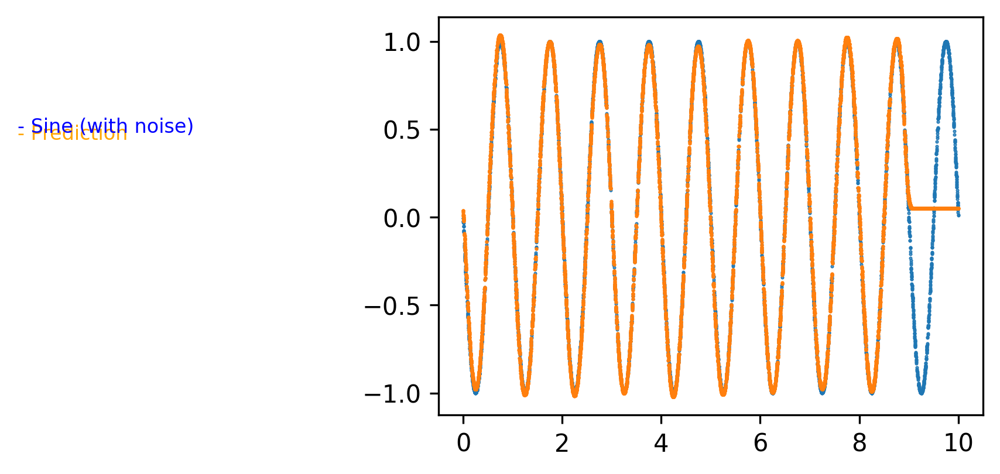

(8000,)
(8000,)


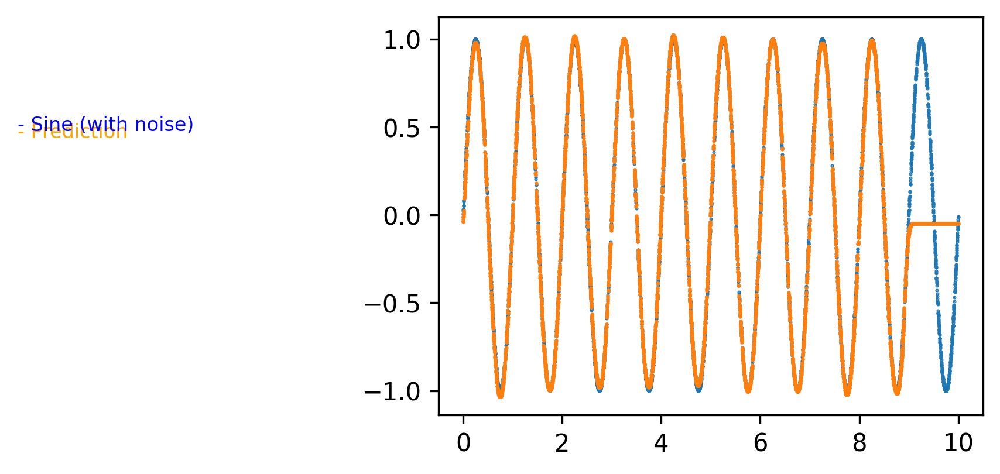

(8000,)
(8000,)


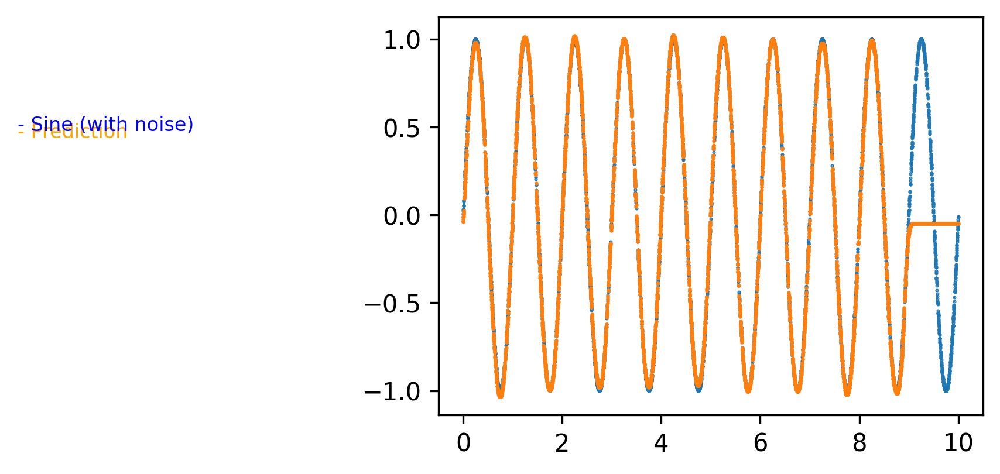

(8000,)
(8000,)


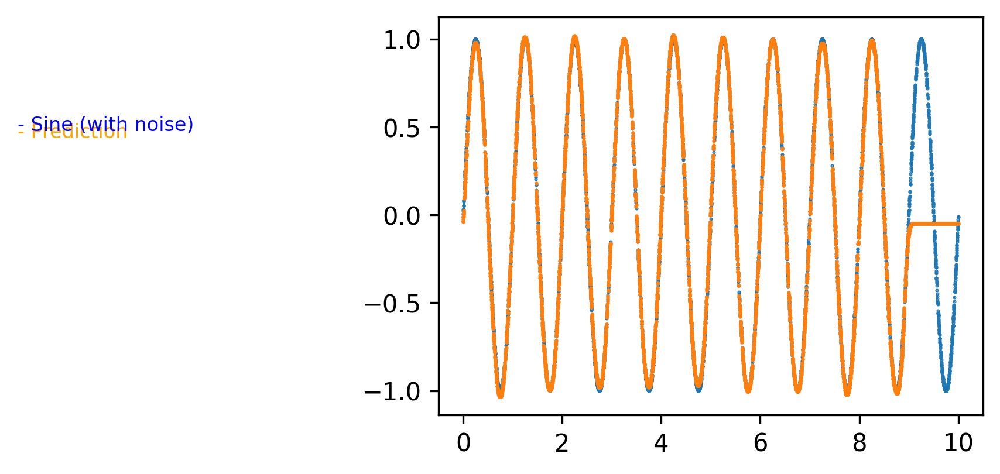

(8000,)
(8000,)


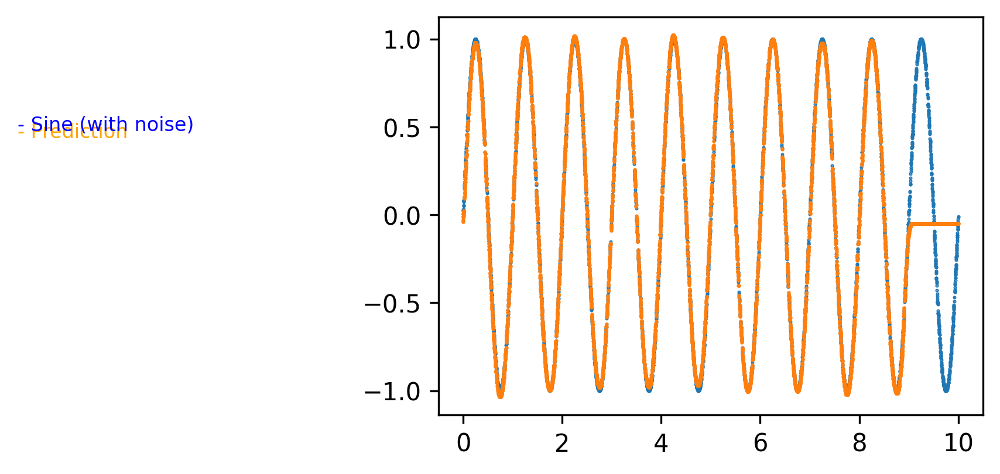

(8000,)
(8000,)


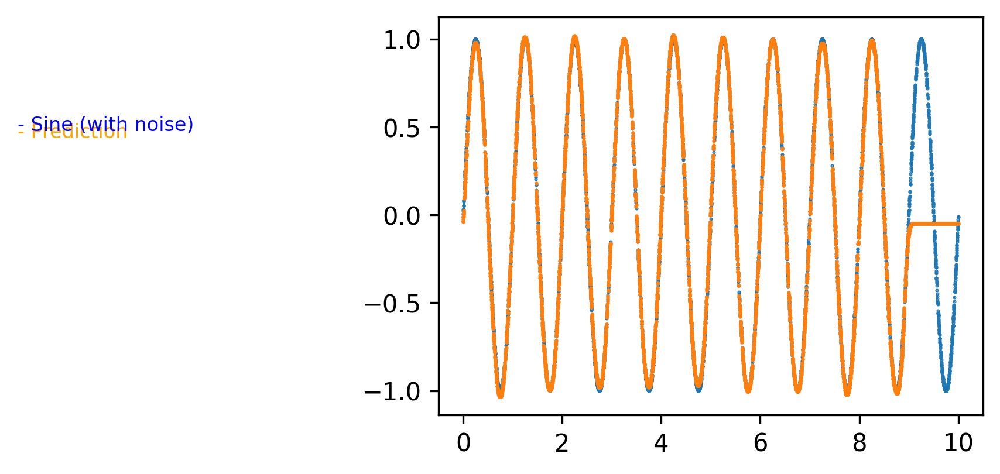

(8000,)
(8000,)


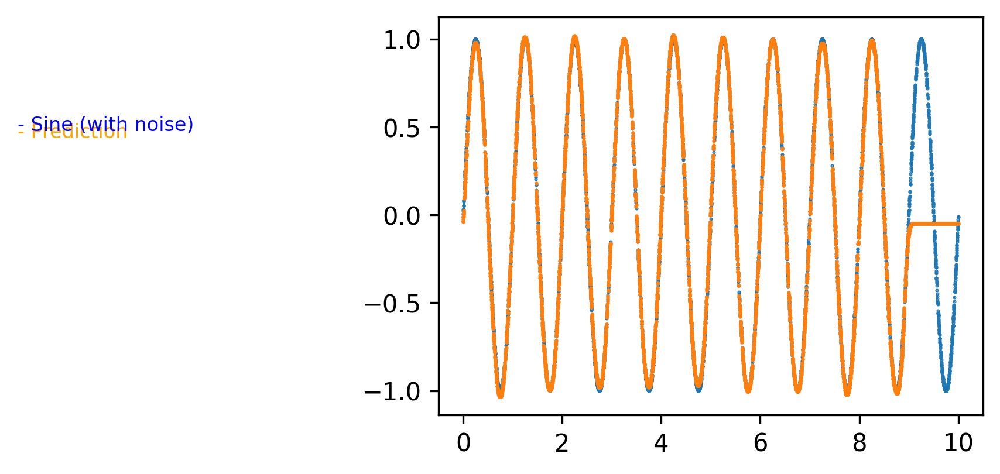

(8000,)
(8000,)


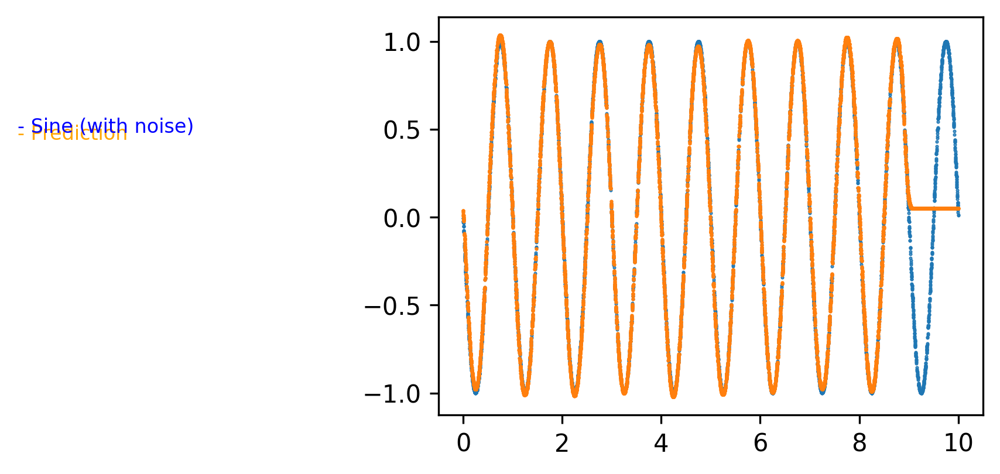

(8000,)
(8000,)


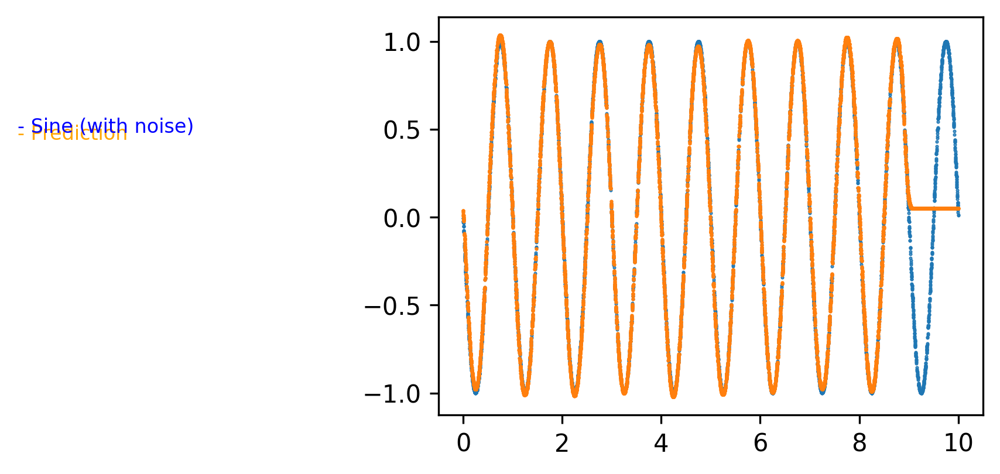

(8000,)
(8000,)


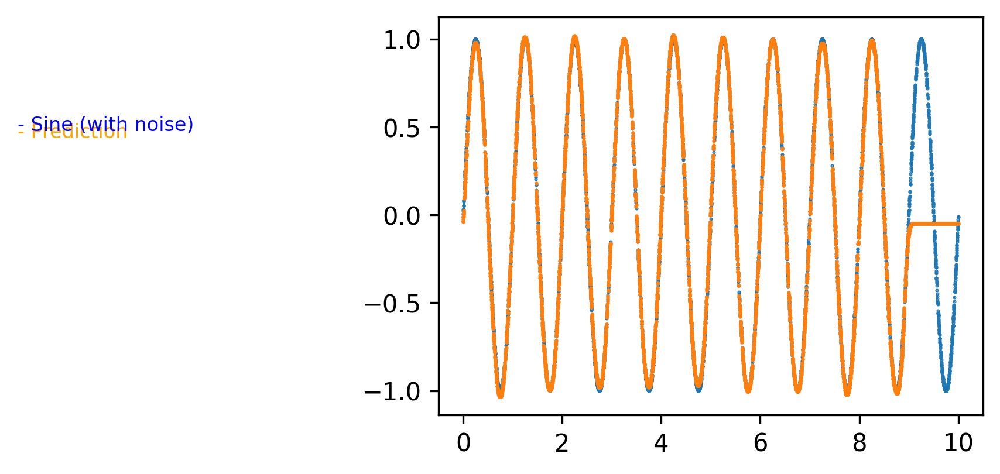

(8000,)
(8000,)


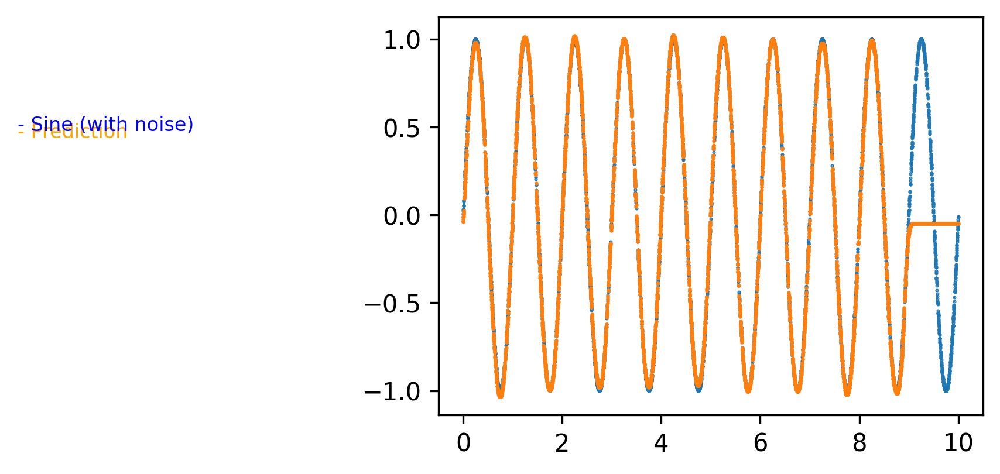

(8000,)
(8000,)


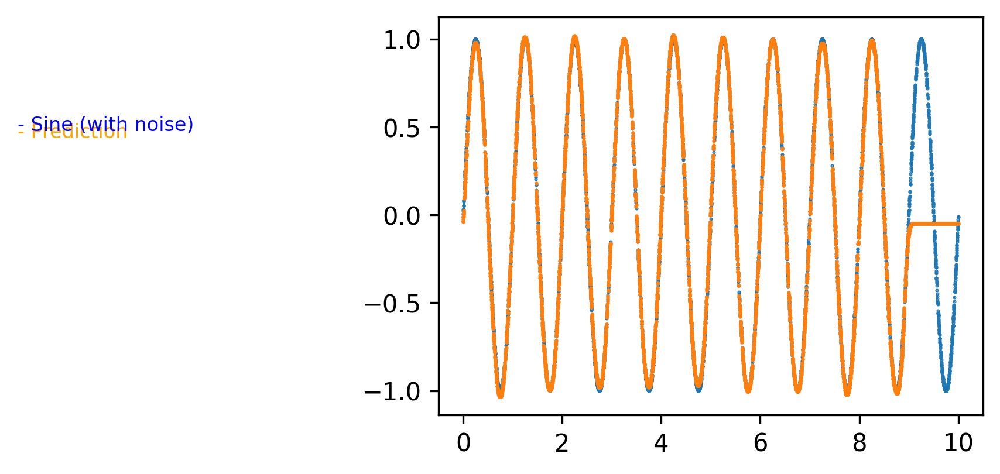

(8000,)
(8000,)


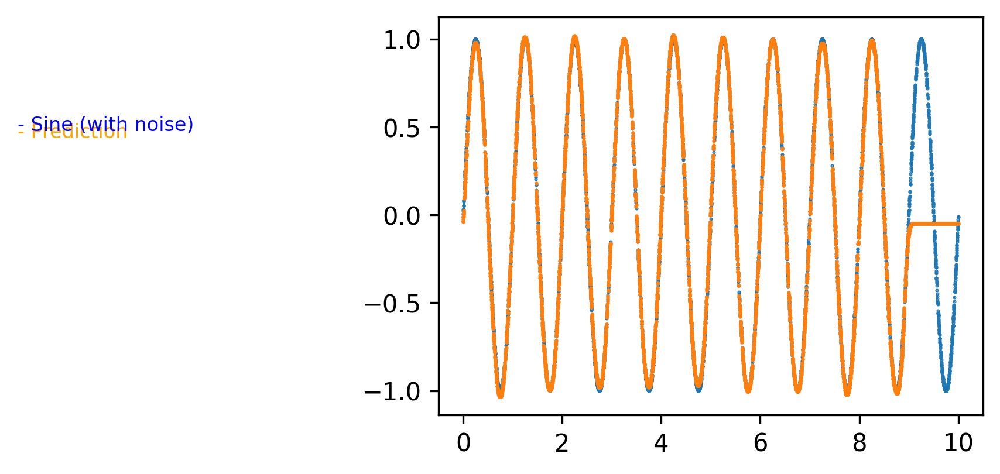

(8000,)
(8000,)


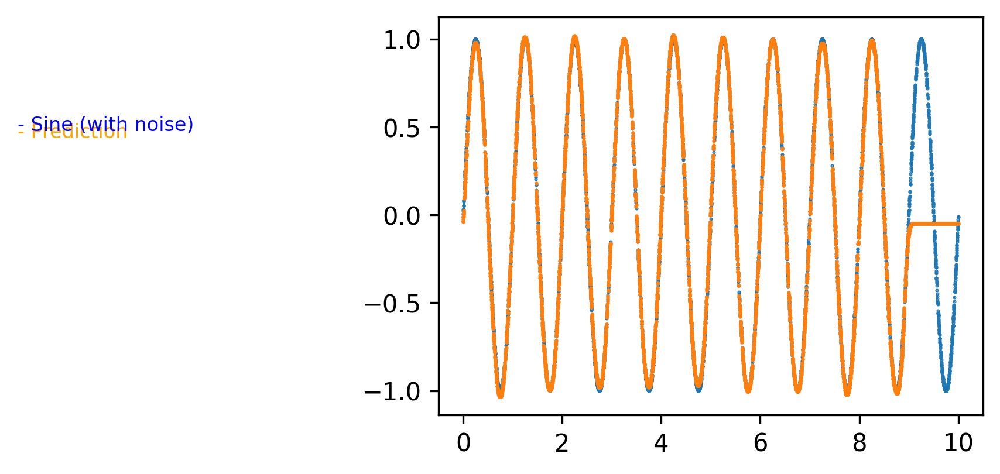

(8000,)
(8000,)


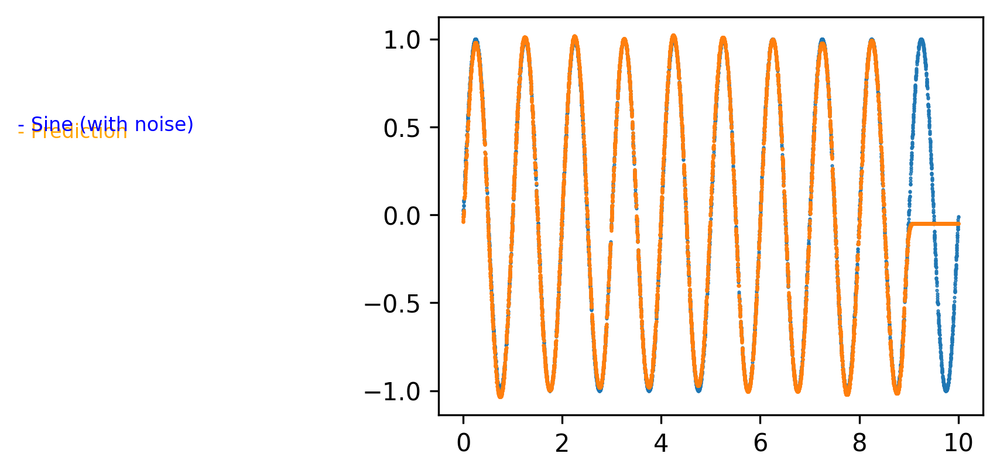

(8000,)
(8000,)


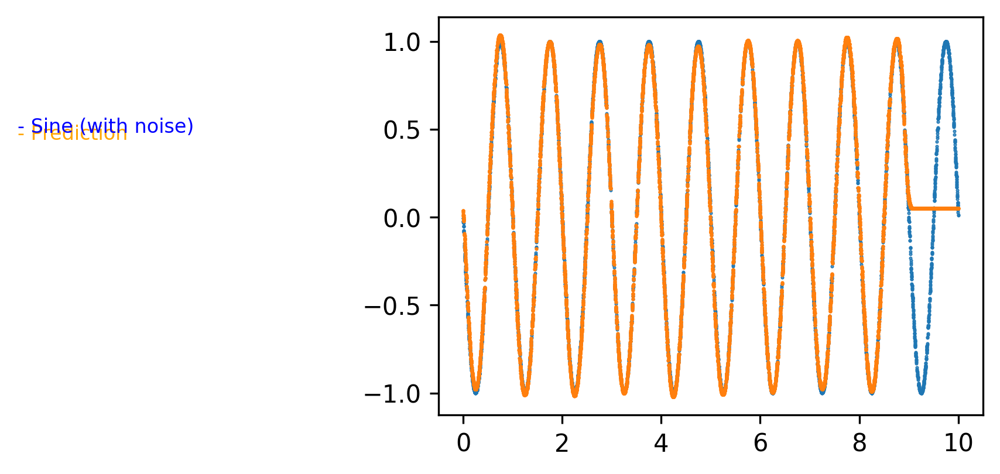

(8000,)
(8000,)


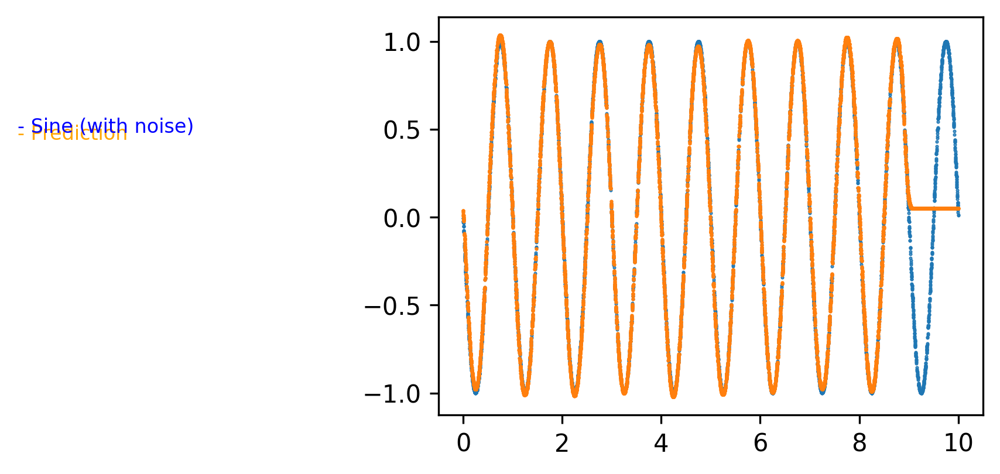

(8000,)
(8000,)


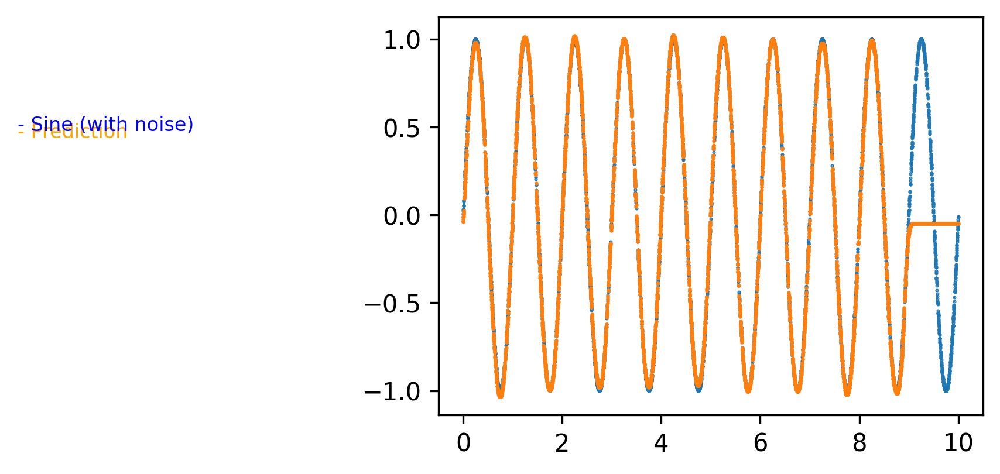

(8000,)
(8000,)


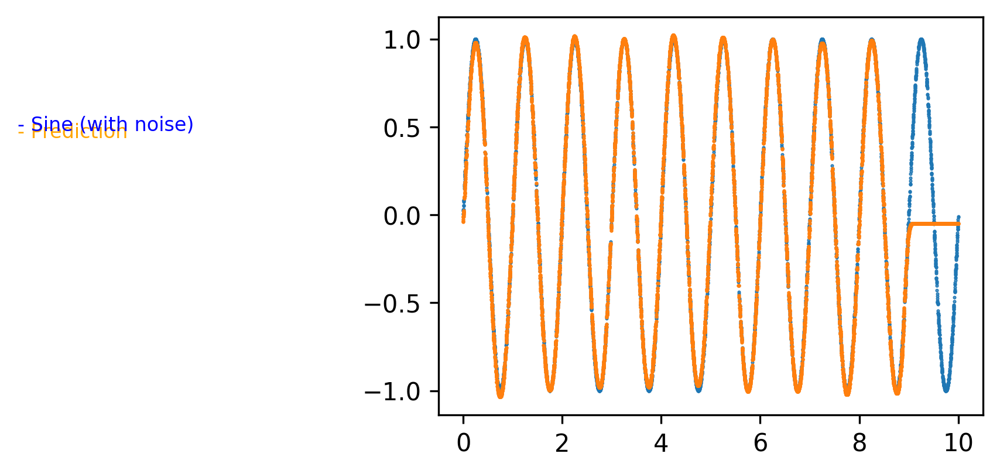

(8000,)
(8000,)


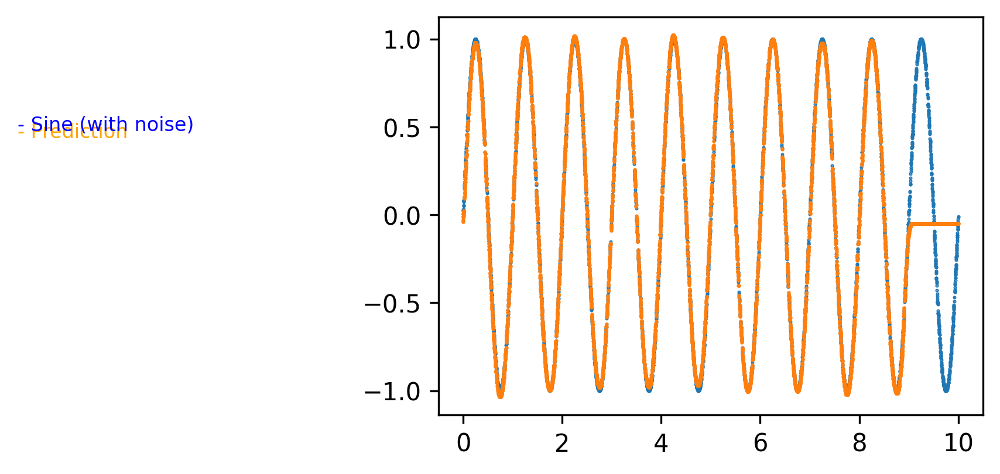

(8000,)
(8000,)


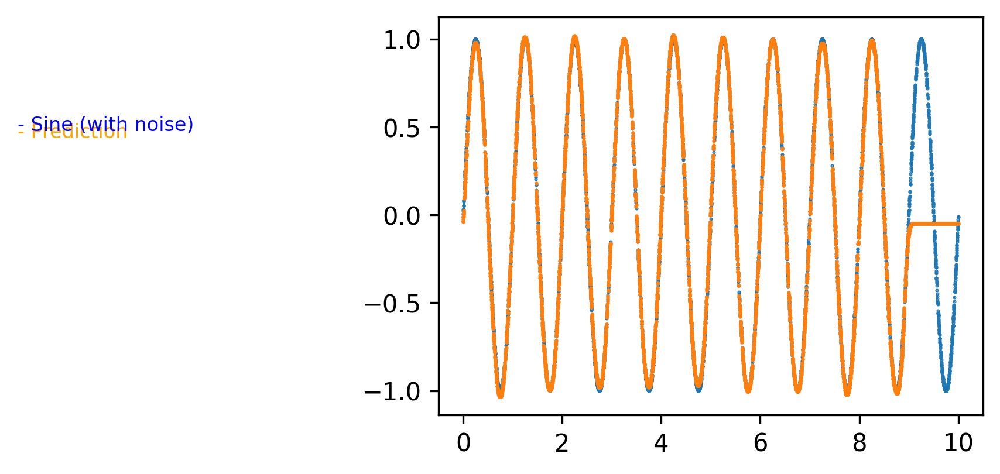

In [ ]:
# Generate a network where the outputs of the ANN are fed back into the inputs on the next timestep.
# Knees are out of phase from hips and lower leg.
# Hips are diagonally coordinated
# 0 and 1: Spine Joints
# 2 and 3: Front Hip Joints
# 4 and 5: Rear Hip Joints
# 6 and 7: Front Mid Legs
# 8 and 9: Rear Mid Legs
# 10 and 11: Front Lower Legs
# 12 and 13: Rear Lower Legs
phase_offsets = [0,0] # Spine
phase_offsets += [0,4,0,0] # Front and Rear Hip Joints
phase_offsets += [0,4,0,0] # Front and Rear Knee Joints
phase_offsets += [0,4,0,0] # Front and Rear Ankle Joints
x_train, y_train, x_test, y_test = gen_train_and_test_data(33, 28, phase_offset=[(np.pi * phase_offsets[i//2])/4.0 for i in range(28)], joint_outputs_to_input=True, for_back_only=False)

ic(type(x_train))
ic(type(y_train))
ic(type(x_test))
ic(type(y_test))

ic(np.shape(x_train))
ic(np.shape(y_train))

dataset_train = SineDataset(x=x_train, y=y_train)
dataset_test = SineDataset(x=x_test, y=y_test)

ic("Train set size: ", dataset_train.length)
ic("Test set size: ", dataset_test.length)

losses, y_predict, model = run(dataset_train=dataset_train, dataset_test=dataset_test, epochs=2000)

ic("Final loss:", sum(losses[-100:])/100)
plot_loss(losses)


y_test = y_test.transpose()
y_predict = y_predict.transpose()

for yt, yp in zip(y_test, y_predict):
  x_data = x_test.transpose()[0]
  ic(np.shape(x_data))
  ic(np.shape(yt))
  #ic(x_test.shape())
  fig2 = pyplot.figure(dpi=300)
  fig2.set_size_inches(4,3)
  pyplot.scatter(x_data, yt, marker='o', s=0.2)
  pyplot.scatter(x_data, yp, marker='o', s=0.3)
  pyplot.text(-9, 0.44, "- Prediction", color="orange", fontsize=8)
  pyplot.text(-9, 0.48, "- Sine (with noise)", color="blue", fontsize=8)
  pyplot.show()

In [ ]:
#from google.colab import drive
#drive.mount('/content/gdrive')

model_save_name = 'sine_three_hips_in_phase_one_out_of_phase_knees_same_as_hips_random_touch_inputs_time_delay_1_joint_inputs.pt'
path = F"/content/gdrive/My Drive/{model_save_name}" 
torch.save(model.state_dict(), path)

In [ ]:
# Generate a network where the outputs of the ANN are fed back into the inputs on the next timestep.
x_train, y_train, x_test, y_test = gen_train_and_test_data(33, 28, phase_offset=[(np.pi * random.randint(0,28))/28.0 for i in range(28)], joint_outputs_to_input=True, for_back_only=True)

ic(type(x_train))
ic(type(y_train))
ic(type(x_test))
ic(type(y_test))

ic(np.shape(x_train))
ic(np.shape(y_train))

dataset_train = SineDataset(x=x_train, y=y_train)
dataset_test = SineDataset(x=x_test, y=y_test)

ic("Train set size: ", dataset_train.length)
ic("Test set size: ", dataset_test.length)

losses, y_predict, model = run(dataset_train=dataset_train, dataset_test=dataset_test, epochs=2000)

ic("Final loss:", sum(losses[-100:])/100)
plot_loss(losses)


y_test = y_test.transpose()
y_predict = y_predict.transpose()

for yt, yp in zip(y_test, y_predict):
  x_data = x_test.transpose()[0]
  ic(np.shape(x_data))
  ic(np.shape(yt))
  #ic(x_test.shape())
  fig2 = pyplot.figure(dpi=300)
  fig2.set_size_inches(8,6)
  pyplot.scatter(x_data, yt, marker='o', s=0.2)
  pyplot.scatter(x_data, yp, marker='o', s=0.3)
  pyplot.text(-9, 0.44, "- Prediction", color="orange", fontsize=8)
  pyplot.text(-9, 0.48, "- Sine (with noise)", color="blue", fontsize=8)
  pyplot.show()

In [ ]:
#from google.colab import drive
#drive.mount('/content/gdrive')

model_save_name = 'random_phases_for_joints_test_1_random_touch_inputs_time_delay_1_joint_inputs.pt'
path = F"/content/gdrive/My Drive/{model_save_name}" 
torch.save(model.state_dict(), path)

In [ ]:
# Generate a network where the outputs of the ANN are fed back into the inputs on the next timestep.
x_train, y_train, x_test, y_test = gen_train_and_test_data(33, 28, phase_offset=[(np.pi * random.randint(0,28))/28.0 for i in range(28)], joint_outputs_to_input=True, for_back_only=True)

ic(type(x_train))
ic(type(y_train))
ic(type(x_test))
ic(type(y_test))

ic(np.shape(x_train))
ic(np.shape(y_train))

dataset_train = SineDataset(x=x_train, y=y_train)
dataset_test = SineDataset(x=x_test, y=y_test)

ic("Train set size: ", dataset_train.length)
ic("Test set size: ", dataset_test.length)

losses, y_predict, model = run(dataset_train=dataset_train, dataset_test=dataset_test, epochs=2000)

ic("Final loss:", sum(losses[-100:])/100)
plot_loss(losses)


y_test = y_test.transpose()
y_predict = y_predict.transpose()

for yt, yp in zip(y_test, y_predict):
  x_data = x_test.transpose()[0]
  ic(np.shape(x_data))
  ic(np.shape(yt))
  #ic(x_test.shape())
  fig2 = pyplot.figure(dpi=300)
  fig2.set_size_inches(8,6)
  pyplot.scatter(x_data, yt, marker='o', s=0.2)
  pyplot.scatter(x_data, yp, marker='o', s=0.3)
  pyplot.text(-9, 0.44, "- Prediction", color="orange", fontsize=8)
  pyplot.text(-9, 0.48, "- Sine (with noise)", color="blue", fontsize=8)
  pyplot.show()

In [ ]:
#from google.colab import drive
#drive.mount('/content/gdrive')

model_save_name = 'random_phases_for_joints_test_2_random_touch_inputs_time_delay_1_joint_inputs.pt'
path = F"/content/gdrive/My Drive/{model_save_name}" 
torch.save(model.state_dict(), path)

(33, 30000)
(30000, 33)
(30000, 28)
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(30000, 33)
(30000, 28)
Train set size:  30000
Test set size:  8000
Epoch:  1
Batches:  1875
Epoch:  51
Batches:  95625
Epoch:  101
Batches:  189375
Epoch:  151
Batches:  283125
Epoch:  201
Batches:  376875
Epoch:  251
Batches:  470625
Epoch:  301
Batches:  564375
Epoch:  351
Batches:  658125
Epoch:  401
Batches:  751875
Epoch:  451
Batches:  845625
Final loss: 0.0006774899551237468


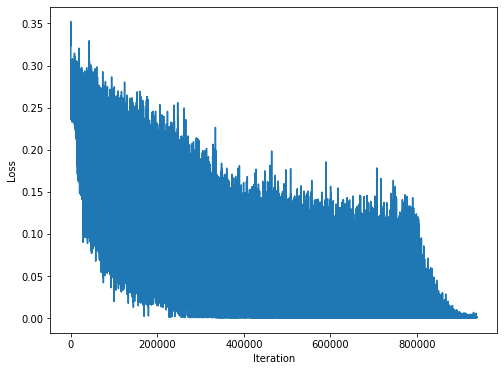

(8000,)
(8000,)


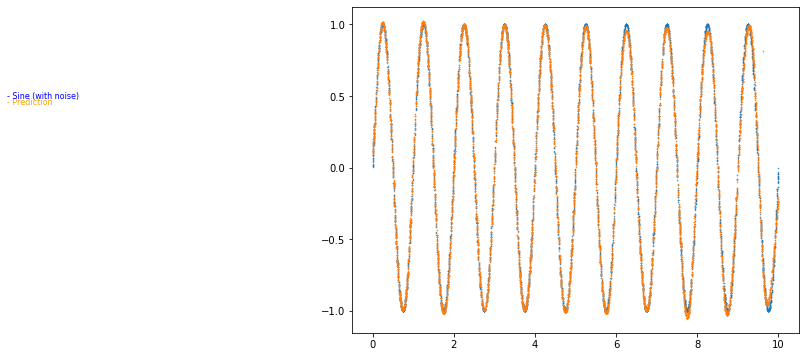

(8000,)
(8000,)


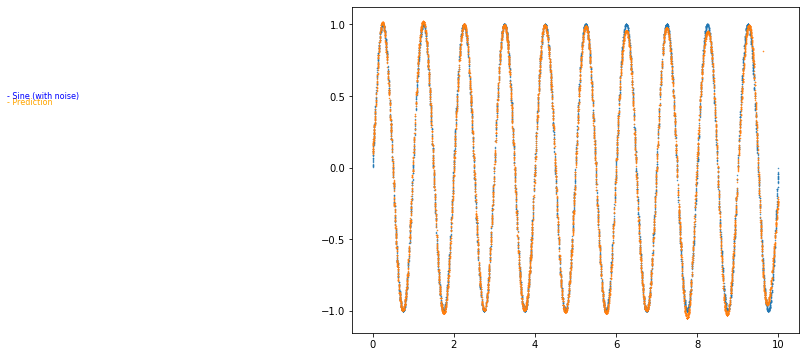

(8000,)
(8000,)


ValueError: ignored

<Figure size 576x432 with 1 Axes>

(8000,)
(8000,)


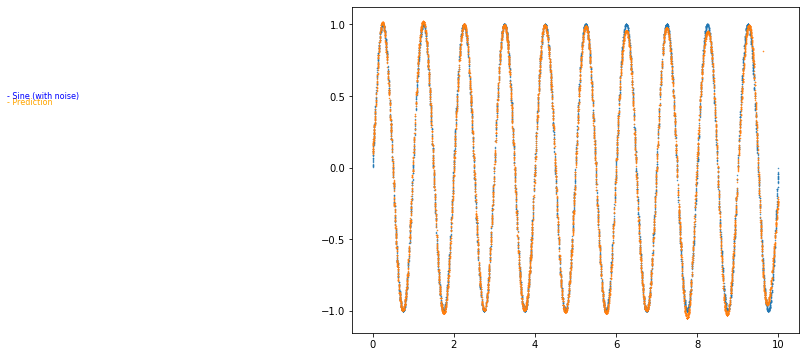

(8000,)
(8000,)


ValueError: ignored

<Figure size 576x432 with 1 Axes>

(8000,)
(8000,)


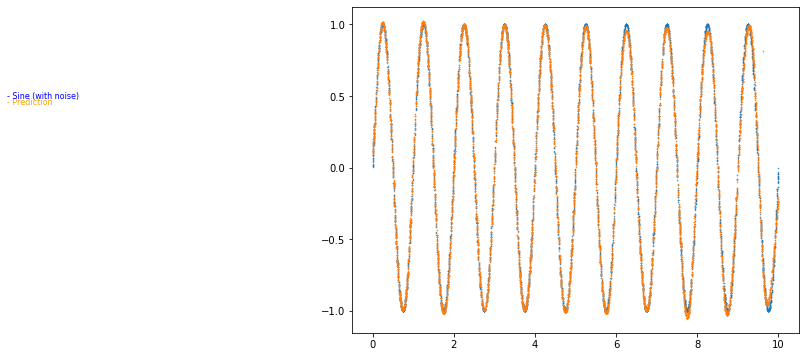

(8000,)
(8000,)


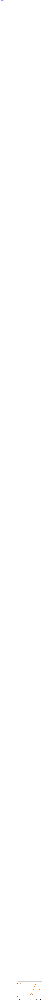

(8000,)
(8000,)


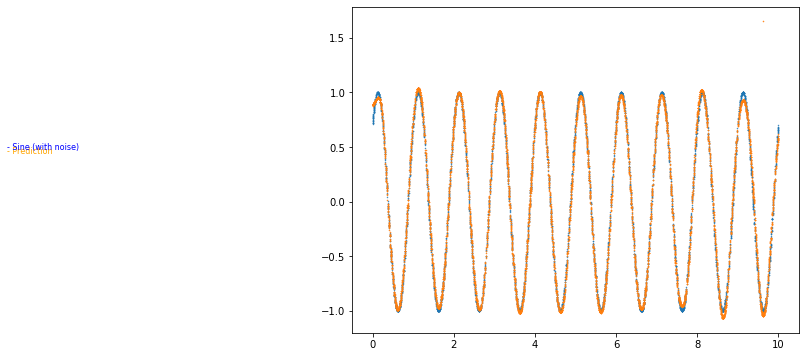

(8000,)
(8000,)


ValueError: ignored

<Figure size 576x432 with 1 Axes>

(8000,)
(8000,)


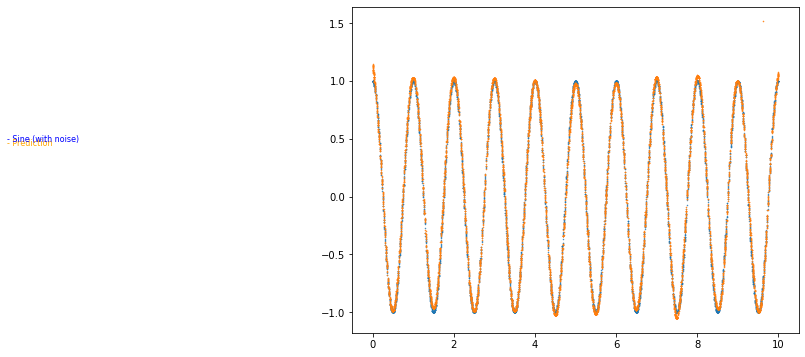

(8000,)
(8000,)


ValueError: ignored

<Figure size 576x432 with 1 Axes>

(8000,)
(8000,)


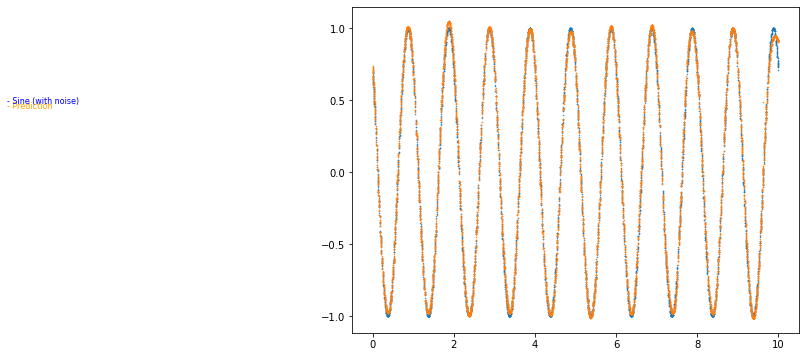

(8000,)
(8000,)


ValueError: ignored

<Figure size 576x432 with 1 Axes>

(8000,)
(8000,)


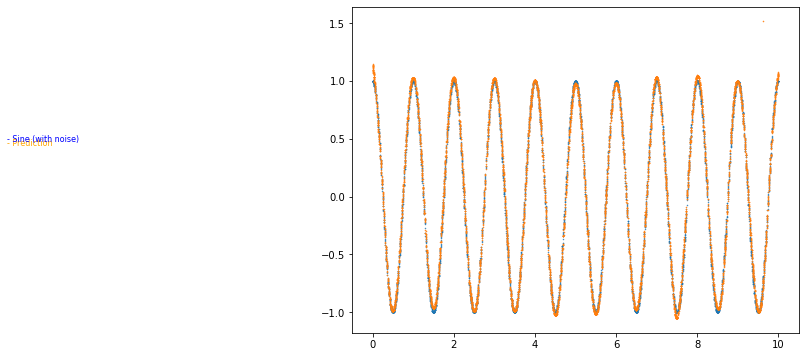

(8000,)
(8000,)


ValueError: ignored

<Figure size 576x432 with 1 Axes>

(8000,)
(8000,)


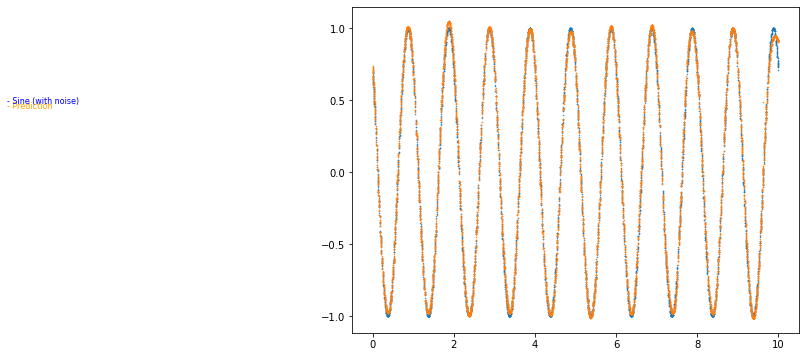

(8000,)
(8000,)


ValueError: ignored

<Figure size 576x432 with 1 Axes>

(8000,)
(8000,)


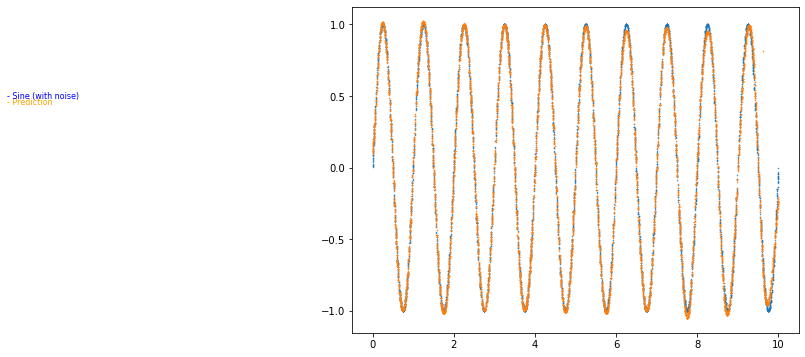

(8000,)
(8000,)


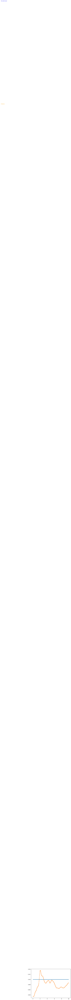

(8000,)
(8000,)


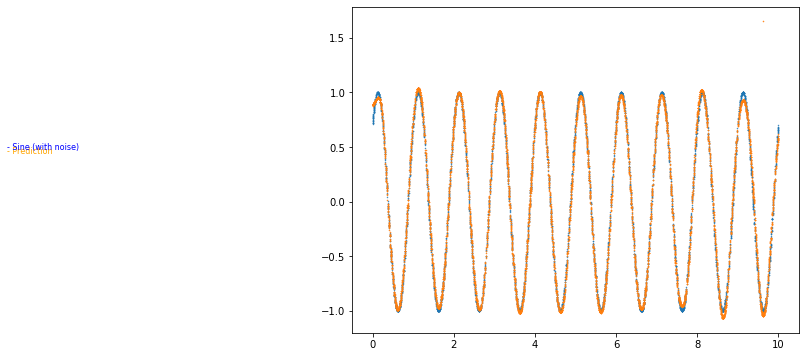

(8000,)
(8000,)


ValueError: ignored

<Figure size 576x432 with 1 Axes>

(8000,)
(8000,)


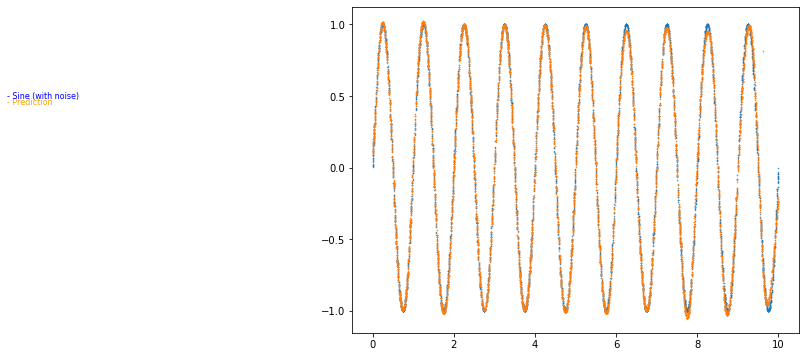

(8000,)
(8000,)


ValueError: ignored

<Figure size 576x432 with 1 Axes>

(8000,)
(8000,)


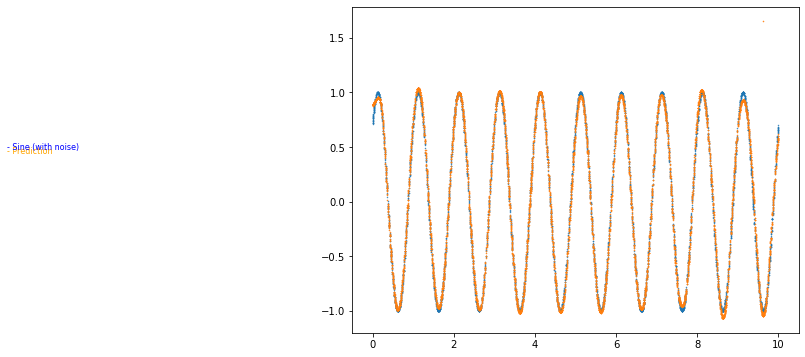

(8000,)
(8000,)


ValueError: ignored

<Figure size 576x432 with 1 Axes>

(8000,)
(8000,)


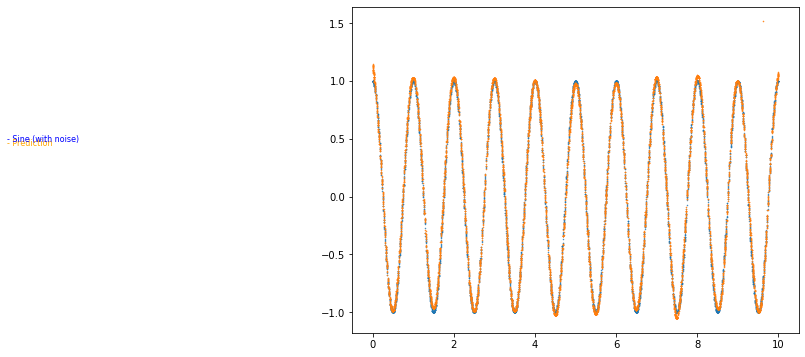

(8000,)
(8000,)


ValueError: ignored

<Figure size 576x432 with 1 Axes>

(8000,)
(8000,)


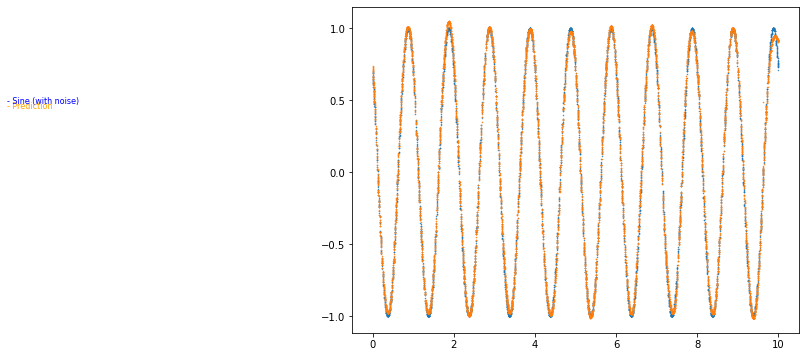

In [ ]:
# Generate a network where the outputs of the ANN are fed back into the inputs on the next timestep.
# Knees are out of phase from hips and lower leg.
# 0 and 1: Spine Joints
# 2 and 3: Front Hip Joints
# 4 and 5: Rear Hip Joints
# 6 and 7: Front Mid Legs
# 8 and 9: Rear Mid Legs
# 10 and 11: Front Lower Legs
# 12 and 13: Rear Lower Legs
phase_offsets = [0,0] # Spine
phase_offsets += [0,2,4,6] # Front and Rear Hip Joints
phase_offsets += [4,6,0,2] # Front and Rear Knee Joints
phase_offsets += [0,2,4,6] # Front and Rear Ankle Joints
x_train, y_train, x_test, y_test = gen_train_and_test_data(33, 28, phase_offset=[(np.pi * phase_offsets[i//2])/8.0 for i in range(28)], joint_outputs_to_input=True, for_back_only=True)

ic(type(x_train))
ic(type(y_train))
ic(type(x_test))
ic(type(y_test))

ic(np.shape(x_train))
ic(np.shape(y_train))

dataset_train = SineDataset(x=x_train, y=y_train)
dataset_test = SineDataset(x=x_test, y=y_test)

ic("Train set size: ", dataset_train.length)
ic("Test set size: ", dataset_test.length)

losses, y_predict, model = run(dataset_train=dataset_train, dataset_test=dataset_test, epochs=500)

ic("Final loss:", sum(losses[-100:])/100)
plot_loss(losses)


y_test = y_test.transpose()
y_predict = y_predict.transpose()

for yt, yp in zip(y_test, y_predict):
  x_data = x_test.transpose()[0]
  ic(np.shape(x_data))
  ic(np.shape(yt))
  #ic(x_test.shape())
  fig2 = pyplot.figure(dpi=300)
  fig2.set_size_inches(8,6)
  pyplot.scatter(x_data, yt, marker='o', s=0.2)
  pyplot.scatter(x_data, yp, marker='o', s=0.3)
  pyplot.text(-9, 0.44, "- Prediction", color="orange", fontsize=8)
  pyplot.text(-9, 0.48, "- Sine (with noise)", color="blue", fontsize=8)
  pyplot.show()

In [ ]:
#from google.colab import drive
#drive.mount('/content/gdrive')

model_save_name = 'front_then_back_gallop_random_touch_inputs_time_delay_1_joint_inputs.pt'
path = F"/content/gdrive/My Drive/{model_save_name}" 
torch.save(model.state_dict(), path)